# Author: Johannes Franz
# 
# This notebook was used to create the density plots of cyto- and angio-architecture across cortical-depth.
# It was run in a docker container (image: tensorflow/tensorflow:2.10.1-gpu-jupyter).

# Workflow

1) File aestetics
    1. CROP
    2. TILE
    3. COMPRESS, and 
    4. SAVE .tif images as .zarr directories

2) Pre-processing
    1. EQUALIZATION: via fast local percentile estimation (similar to ClearMap but now 1) implemented on the GPU with 2) sparse structuring elements)
    2. (BACKGROUND-SUBTRACTION)

3) Cortex segmentation
    1. DOWNSAMPLE: both angio and cyto channels from 1x1x1 to 10x2x2 (nearest neighbour, striding), save as .nii
    2. MANUAL SEGMENTATION: in ITK-SNAP
    3. SMOOTHING: STD of 10 pixels
    3. RE-SAMPLE: to 10x10x10

4) Layering
    1. LAYNII: due to the small FOV, we use only the equidistant metric for now

5) Depth-profiles
    1. 

# Installs

In [1]:
# for opencv
! apt-get update && apt-get install ffmpeg libsm6 libxext6  -y

Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease [1581 B]
Get:2 http://security.ubuntu.com/ubuntu focal-security InRelease [128 kB]      
Hit:3 http://archive.ubuntu.com/ubuntu focal InRelease                       
Get:4 http://archive.ubuntu.com/ubuntu focal-updates InRelease [128 kB]      
Hit:5 http://archive.ubuntu.com/ubuntu focal-backports InRelease               
Get:6 http://security.ubuntu.com/ubuntu focal-security/universe amd64 Packages [1274 kB]
Get:7 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1561 kB]
Ign:8 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  Packages [1724 kB]
Get:10 http://security.ubuntu.com/ubuntu focal-security/main amd64 Packages [4025 kB]
Get:11 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 Packages [4488 kB]
Hit:12 https://developer.downloa

In [2]:
! pip install -r pydepthmap/requirements.txt

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


#### Reload

In [1]:
%load_ext autoreload
%autoreload 2

# Setup Cuda

In [2]:
use_cuda = True

In [3]:
if use_cuda:
    ! nvidia-smi

Tue Oct 22 20:09:50 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.256.02   Driver Version: 470.256.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0  On |                  N/A |
| 31%   49C    P0    42W / 151W |    545MiB /  8117MiB |      3%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Imports

In [4]:
import sys
import os
import warnings

import numpy as np

import scipy.ndimage
import scipy.stats
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
from scipy.interpolate import interp1d
from scipy.ndimage import distance_transform_edt

from edt import edt
import tifffile
import skimage
from skimage.io import imread

from skimage.util import view_as_windows
from skimage.filters import sato, median, gaussian
from skimage.filters.rank import percentile, maximum
from skimage.restoration import rolling_ball
from skimage.morphology import disk, ball, opening, area_opening, closing, binary_erosion, binary_dilation
from skimage.morphology import skeletonize
from skimage.exposure import match_histograms
from scipy.ndimage import zoom
import cv2
import porespy as ps

from skimage.color import rgb2hsv, hsv2rgb
from skimage import morphology

import nibabel as nb

import dask
from dask import delayed
import dask.array as da
from dask.array import map_overlap
from dask_image import ndinterp

from dask_image.ndmeasure import label as da_label
import dask.dataframe as dd

from matplotlib import pyplot as plt
%matplotlib inline
import imageio

import zarr
from tqdm import tqdm
import pandas as pd
import copy

from microfilm.microplot import microshow
from microfilm import microplot
from microfilm.microplot import Micropanel

[20:09:52] ERROR    PARDISO solver not installed, run `pip install pypardiso`. Otherwise,          ]8;id=590211;file:///usr/local/lib/python3.8/dist-packages/openpnm/utils/_workspace.py\_workspace.py]8;;\:]8;id=684746;file:///usr/local/lib/python3.8/dist-packages/openpnm/utils/_workspace.py#56\56]8;;\
                    simulations will be slow. Apple M chips not supported.                                         

In [5]:
from local_thickness_dahl.localthickness import local_thickness as apply_local_thickness_dahl


# Config

In [6]:
plt.rcParams["figure.figsize"] = [6.4, 4.8]

In [7]:
from_scratch = False

# Dask Setup

In [8]:
# https://saturncloud.io/blog/local-cluster/
# TODO 
# in terminal
#  dask-scheduler
# in other terminal
#  dask-worker tcp://127.0.0.1:8786 --nprocs 4 --memory-limit 10GB
# in notebook
#from dask.distributed import Client
#client = Client('tcp://127.0.0.1:8786')

In [9]:
#from dask.distributed import Client
#from dask.distributed import LocalCluster

In [10]:
#cluster = LocalCluster(n_workers=1, threads_per_worker=10, memory_limit='10G')

In [11]:
#client = Client(cluster)

In [12]:
#client

In [13]:
#client.shutdown()

In [14]:
#from dask_cuda import LocalCUDACluster
#from dask.distributed import Client
#cluster = LocalCUDACluster(n_workers=1)
#client = Client(cluster)

# own Imports

In [15]:
from pydepthmap.data import DataSet
import pydepthmap.utils as pdm_u
import pydepthmap.filters as pdm_f
import pydepthmap.visualization as pdm_v
import pydepthmap.core as pdm

# parameters

In [16]:
n_depthbins = 100

# Loading

### Original files

In [17]:
# For convenience, we work mostly with .zarr arrays
# Also for convenience, we use a subset of the data
#  specifically, each channel is of shape (1001, 2048, 2048)
#  we use [:1000, :2000, :2000] allowing convenient tiling

resave_mod_cyto = {'roi': [[None, 1000], 
                           [0, 1], 
                           [None, 2000], 
                           [None, 2000]], 
                   'chunk_size': 200}
resave_mod_angio = {'roi': [[None, 1000], 
                            [1, 2], 
                            [None, 2000], 
                            [None, 2000]], 
                    'chunk_size': 200}
raw_config = {'general': {'folder': os.getcwd(), 
                          'description': ['region', 'channel']}, 
              'raw_entries': [
                  {'files': {'tif': 'Occlobe10_8_HR_6,3_V1_composite_350-1350.tif'}, 
                   'region': 'v1', 
                   'channel': 'cyto', 
                   'resave_mod': copy.deepcopy(resave_mod_cyto)},
                  {'files': {'tif': 'Occlobe10_8_HR_6,3_V1_composite_350-1350.tif'}, 
                   'region': 'v1', 
                   'channel': 'angio', 
                   'resave_mod': copy.deepcopy(resave_mod_angio)},
                  {'files': {'tif': 'Occlobe10_8_HR_6,3_V2_composite_200-1200.tif'}, 
                   'region': 'v2', 
                   'channel': 'cyto', 
                   'resave_mod': copy.deepcopy(resave_mod_cyto)},
                  {'files': {'tif': 'Occlobe10_8_HR_6,3_V2_composite_200-1200.tif'}, 
                   'region': 'v2', 
                   'channel': 'angio', 
                   'resave_mod': copy.deepcopy(resave_mod_angio)},
              ]}

In [18]:
ds = DataSet(**raw_config, verbose=True)

Converting v1_cyto to zarr
/tf/angio/Occlobe10_8_HR_6,3_V1_composite_350-1350_cyto.zarr already exists, loading from file
Added entry: v1_cyto

Converting v1_angio to zarr
/tf/angio/Occlobe10_8_HR_6,3_V1_composite_350-1350_angio.zarr already exists, loading from file
Added entry: v1_angio

Converting v2_cyto to zarr
/tf/angio/Occlobe10_8_HR_6,3_V2_composite_200-1200_cyto.zarr already exists, loading from file
Added entry: v2_cyto

Converting v2_angio to zarr
/tf/angio/Occlobe10_8_HR_6,3_V2_composite_200-1200_angio.zarr already exists, loading from file
Added entry: v2_angio



In [19]:
# Add derivatives: angio LoG segmentation
resave_mod = {'roi': [[None, 1000], 
                      [None, 2000], 
                      [None, 2000]], 
              'chunk_size': 200}
derivative_config = {'files': {'tif': 'V1_LoG2_4_binaries_combined.tif'}, 
                     'parent': 'v1_angio', 
                     'region': 'v1', 
                     'channel': 'angio', 
                     'resave_mod': copy.deepcopy(resave_mod), 
                     'special': 'LoG.segmentation'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'tif': 'V2_LoG2_4_binaries_combined.tif'}, 
                     'parent': 'v2_angio', 
                     'region': 'v2', 
                     'channel': 'angio', 
                     'resave_mod': copy.deepcopy(resave_mod), 
                     'special': 'LoG.segmentation'}
ds.add_derivative(derivative_config);

Converting v1_angio_LoG.segmentation to zarr
/tf/angio/V1_LoG2_4_binaries_combined_angio.zarr already exists, loading from file
Added entry: v1_angio_LoG.segmentation

Converting v2_angio_LoG.segmentation to zarr
/tf/angio/V2_LoG2_4_binaries_combined_angio.zarr already exists, loading from file
Added entry: v2_angio_LoG.segmentation



In [20]:
# Add derivatives: angio TubeMap segmentation
load_mod = {'roi': [[None, 1000], 
                    [None, 2000], 
                    [None, 2000]]}
derivative_config = {'files': {'zarr': '/tf/angio/Occlobe10_8_HR_6,3_V1_composite_350-1350_angio_binary.zarr'}, 
                     'parent': 'v1_angio', 
                     'region': 'v1', 
                     'channel': 'angio', 
                     'load_mod': copy.deepcopy(load_mod), 
                     'special': 'TubeMap.segmentation'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'zarr': '/tf/angio/Occlobe10_8_HR_6,3_V2_composite_200-1200_angio_binary.zarr'}, 
                     'parent': 'v2_angio', 
                     'region': 'v2', 
                     'channel': 'angio', 
                     'load_mod': copy.deepcopy(load_mod),
                     'special': 'TubeMap.segmentation'}
ds.add_derivative(derivative_config);

Added entry: v1_angio_TubeMap.segmentation

Added entry: v2_angio_TubeMap.segmentation



In [21]:
# Add derivatives: cyto registered (moving) images
load_mod = {'roi': [[None, 1000], 
                    [None, 2000], 
                    [None, 2000]]}
derivative_config = {'files': {'zarr': 'v1_cyto_fused_zarr/v1_cyto_fused.zarr/fused_tp_0_ch_0/s0/'}, 
                     'parent': 'v1_cyto', 
                     'region': 'v1', 
                     'channel': 'cyto', 
                     'load_mod': copy.deepcopy(load_mod), 
                     'special': 'reg'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'zarr': 'v2_cyto_fused_zarr/v2_cyto_fused.zarr/fused_tp_0_ch_0/s0/'}, 
                     'parent': 'v2_cyto', 
                     'region': 'v2', 
                     'channel': 'cyto', 
                     'load_mod': copy.deepcopy(load_mod),
                     'special': 'reg'}
ds.add_derivative(derivative_config);

Added entry: v1_cyto_reg

Added entry: v2_cyto_reg



In [22]:
# Add derivatives: cyto StarDist segmentation
load_mod = {'roi': [[None, 1000], 
                    [None, 2000], 
                    [None, 2000]]}
derivative_config = {'files': {'zarr': 'stardist_predict_instances_big_v1_reg.zarr'}, 
                     'parent': 'v1_cyto', 
                     'region': 'v1', 
                     'channel': 'cyto', 
                     'load_mod': copy.deepcopy(load_mod), 
                     'special': 'StarDist.segmentation'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'zarr': 'stardist_predict_instances_big_v2_reg.zarr'}, 
                     'parent': 'v2_cyto', 
                     'region': 'v2', 
                     'channel': 'cyto', 
                     'load_mod': copy.deepcopy(load_mod),
                     'special': 'StarDist.segmentation'}
ds.add_derivative(derivative_config);

Added entry: v1_cyto_StarDist.segmentation

Added entry: v2_cyto_StarDist.segmentation



In [140]:
# Add StarDist measurements
StarDist_labels = ['dist', 
                   'prob', 
                   'points', 
                   'rays_faces', 
                   'rays_vertices']

v1_stardist_stats = {}
fn = 'v1_cyto_fused_stardist'
for lbl in StarDist_labels:
    v1_stardist_stats[lbl] = np.load(fn + '_' + lbl + '.npy')
ds.entries['v1_cyto_StarDist.segmentation']['measurements'] = v1_stardist_stats
    
v2_stardist_stats = {}
fn = 'v2_cyto_fused_stardist'
for lbl in StarDist_labels:
    v2_stardist_stats[lbl] = np.load(fn + '_' + lbl + '.npy')
ds.entries['v2_cyto_StarDist.segmentation']['measurements'] = v2_stardist_stats


In [24]:
# Add derivatives: orientation hsv
load_mod = {'roi': [[None, 1000], 
                    [None, 2000], 
                    [None, 2000]], 
            'chunk_size': [200, 200, 200, 3]}
derivative_config = {'files': {'zarr': '10_8_HR_V1_CM_hsv.zarr'}, 
                     'parent': 'v1_angio', 
                     'region': 'v1', 
                     'channel': 'angio', 
                     'load_mod': copy.deepcopy(load_mod), 
                     'special': 'orientation.hsv'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'zarr': 'V2_CM_hsv.zarr'}, 
                     'parent': 'v2_angio', 
                     'region': 'v2', 
                     'channel': 'angio', 
                     'load_mod': copy.deepcopy(load_mod),
                     'special': 'orientation.hsv'}
ds.add_derivative(derivative_config);

# NOTE: originally these came from .tif files from OrientationJ
# they were first converted to .zarr and then from rgb2hsv, a bit like
#def f(im):
#    o = rgb2hsv(im)
#    return o
#hsv = ori.map_blocks(f, dtype=np.float64)

Added entry: v1_angio_orientation.hsv

Added entry: v2_angio_orientation.hsv



In [25]:
#np.sum([v.nbytes for v in v1_stardist_stats.values()]) / 1024**3

In [26]:
#d = da.from_zarr('V2_LoG2_4_binaries_combined.zarr')
# NOTE: imagej=True makes this tif memory-meppable
#tifffile.imsave('V2_LoG2_4_binaries_combined.tif', d.astype(np.uint16), imagej=True)

In [27]:
# variable names lost
# v1_im_data_cyto
# v1_im_data_angio
# v1_angio_seg_data

# v2_im_data_cyto
# v2_im_data_angio
# v2_angio_seg_data

# File-size comparison

In [28]:
for name, entry in ds.entries.items():
    if np.all([fn in entry['files'] for fn in ['tif', 'zarr']]):
        tif_size_gb = os.path.getsize(entry['files']['tif']) / 1024**3
        # NOTE: in principle we cut away ~ 4% of the data so this comparison is not perfect 
        # (would expect at least a ratio of 1.04)
        if name in ['v1_cyto', 'v1_angio', 'v2_cyto', 'v2_angio']:
            tif_size_gb /= 2
        zarr_size_gb = pdm_u.get_zarr_size_on_disk(entry['files']['zarr'])
        print(f"""{name} 
        tif_size: {np.round(tif_size_gb, 3)}, 
        zarr_size: {np.round(zarr_size_gb, 3)}, 
        ratio: {np.round(tif_size_gb / zarr_size_gb, 3)}\n""")

v1_cyto 
        tif_size: 7.82, 
        zarr_size: 6.462, 
        ratio: 1.21

v1_angio 
        tif_size: 7.82, 
        zarr_size: 4.552, 
        ratio: 1.718

v2_cyto 
        tif_size: 7.82, 
        zarr_size: 6.002, 
        ratio: 1.303

v2_angio 
        tif_size: 7.82, 
        zarr_size: 4.572, 
        ratio: 1.711

v1_angio_LoG.segmentation 
        tif_size: 7.82, 
        zarr_size: 0.389, 
        ratio: 20.129

v2_angio_LoG.segmentation 
        tif_size: 7.82, 
        zarr_size: 0.35, 
        ratio: 22.356



# Channel-Registration

In [29]:
# Done with BigSticher
# (see README and manuscript)

#### Inspect registration results - V1

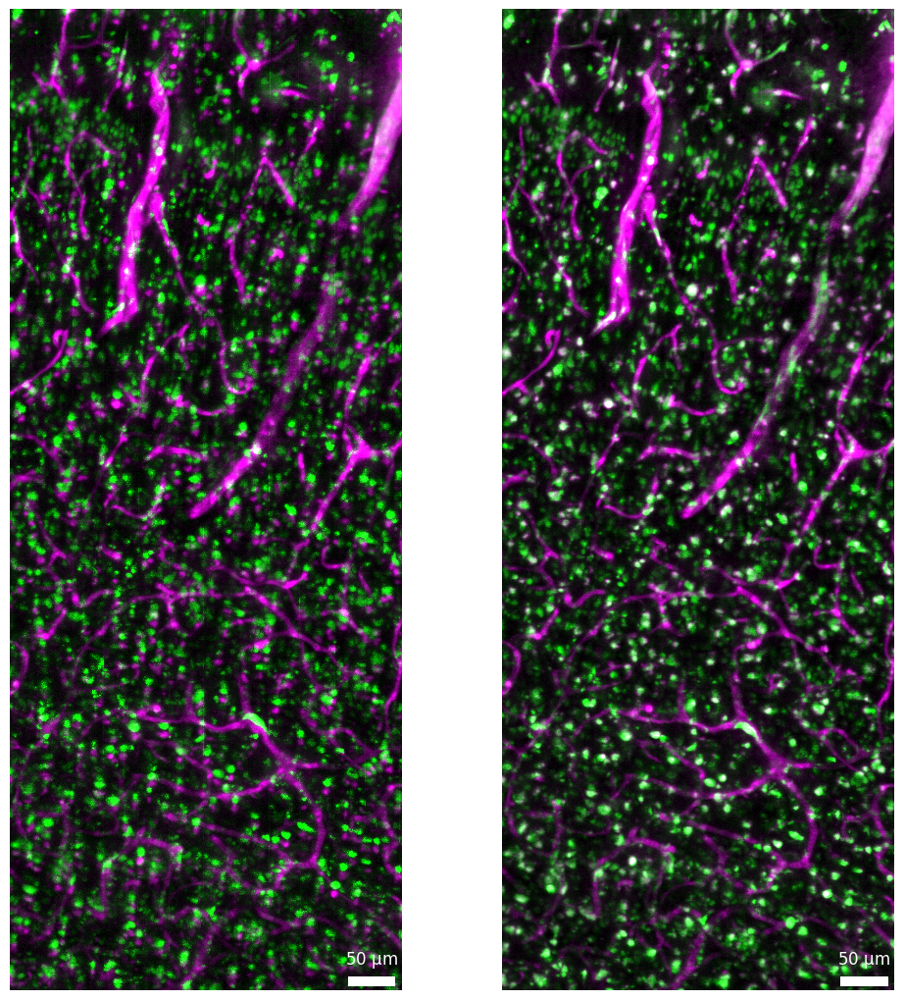

In [30]:
roi = tuple([slice(700, 750), 
             slice(300, 1300), 
             slice(1200, 1600)])
pdm_v.show_before_after([ds.get_data('v1_angio'), 
                         ds.get_data('v1_cyto')], 
                         [ds.get_data('v1_angio'), 
                          ds.get_data('v1_cyto_reg')], 
                         ['pure_magenta', 'pure_green'], 
                          roi=roi, 
                          mip=0, 
                          preprocess=[pdm_f.preproc_angio_for_vis, 
                                      pdm_f.preproc_cyto_for_vis], 
                          match_histograms_between_channels=True)

#### Inspect registration results - V2

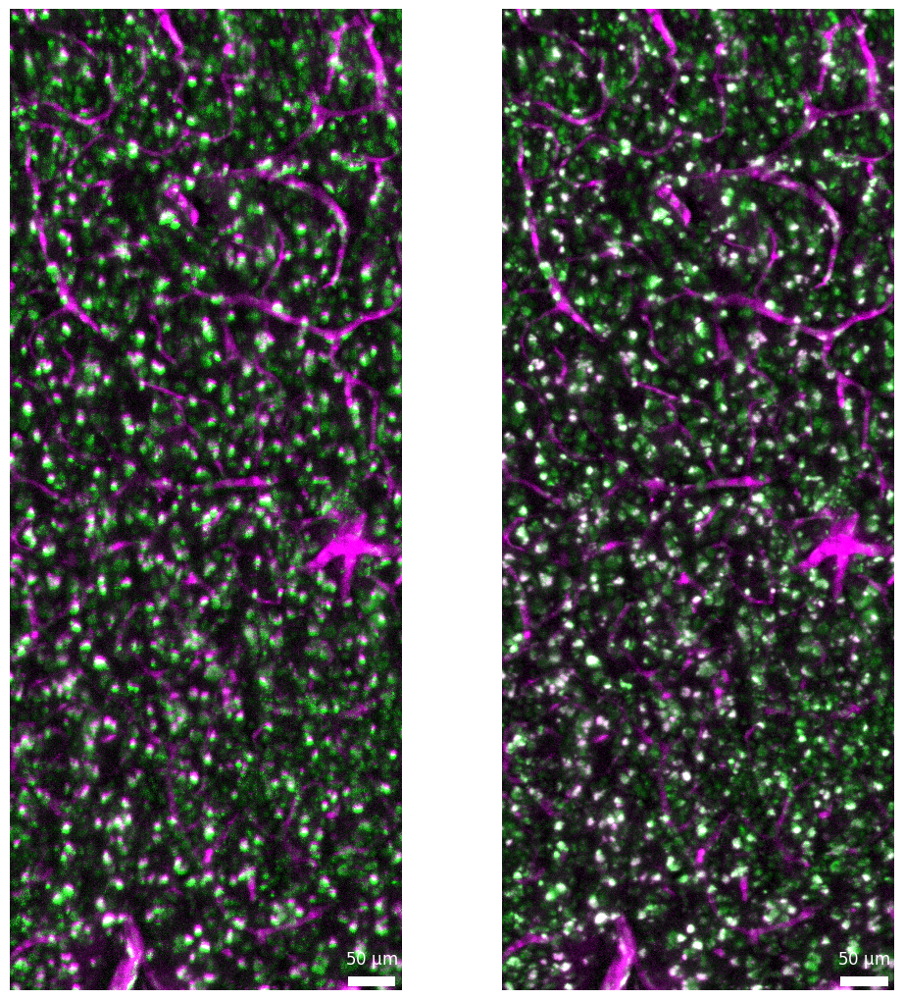

In [31]:
v2_crop = tuple([slice(140, 190), 
                 slice(200, 1200), 
                 slice(1000, 1400)])
pdm_v.show_before_after([ds.get_data('v2_angio'), 
                         ds.get_data('v2_cyto')], 
                        [ds.get_data('v2_angio'), 
                         ds.get_data('v2_cyto_reg')], 
                        ['pure_magenta', 'pure_green'], 
                        roi=roi, 
                        mip=0, 
                        preprocess=[pdm_f.preproc_angio_for_vis, 
                                    pdm_f.preproc_cyto_for_vis], 
                        match_histograms_between_channels=True)

# Cell-segmentation

#### Get sub-volumes for manual segmentation

In [32]:
data = ds.get_data('v1_cyto_reg')
out_folder = os.path.join(ds.folder, 'man_seg')
out_prefix = 'v1_cyto_tiff'
w, z, y, x = 150, [25, 725], [250, 1000, 1500], [250, 1500]
pdm_u.get_sub_volumes_for_manual_annotation(data, 
                                            out_folder, 
                                            out_prefix, 
                                            w, z, y, x)

/tf/angio/man_seg/v1_cyto_tiff_z25_y250_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z25_y250_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z25_y1000_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z25_y1000_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z25_y1500_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z25_y1500_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y250_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y250_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y1000_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y1000_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y1500_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v1_cyto_tiff_z725_y1500_x1500_w150.tif already exists, skipping


In [33]:
data = ds.get_data('v2_cyto_reg')
out_folder = os.path.join(ds.folder, 'man_seg')
out_prefix = 'v2_cyto_tiff'
w, z, y, x = 150, [25, 725], [250, 1000, 1500], [250, 1500]
pdm_u.get_sub_volumes_for_manual_annotation(data, 
                                            out_folder, 
                                            out_prefix, 
                                            w, z, y, x)

/tf/angio/man_seg/v2_cyto_tiff_z25_y250_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z25_y250_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z25_y1000_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z25_y1000_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z25_y1500_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z25_y1500_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y250_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y250_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y1000_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y1000_x1500_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y1500_x250_w150.tif already exists, skipping
/tf/angio/man_seg/v2_cyto_tiff_z725_y1500_x1500_w150.tif already exists, skipping


#### Manual cell-segmentation

In [34]:
# This was done using a combination of 
# Labkit
# Napari (especially the tools for manually splitting and merging labels inside the 
#         napari-segment-blobs-and-things-with-membranes plugin)
# ITKSnap
# (see README and manuscript)

#### Automatic cell-segmentation (StarDist)

In [35]:
# see StarDist.ipynb

In [36]:
# TODO load results here

# Cortex Segmentation (ITKSnap)

#### Downsample for segmentation

In [37]:
# downsampling from voxelsize 1x1x1um to 10:2:2um
# Across depth, take MIPs over 5 slices at every 10 slices
# remove background, equalize
# then downsample 2*2 in-plane (striding/nearest-neighbour)

In [38]:
mip_r = 10
mip_step = 10
stride = 2
overwrite = False
special = 'downsampled'

for region in ['v1', 'v2']:
    for channel in ['cyto', 'angio']:
        entry = f'{region}_{channel}'
        postfix = f'_{channel}_pp_zoom0pt1_0pt5_0pt5.nii'
        postprocess = [pdm_f.preproc_cyto_for_vis if channel=='cyto' else pdm_f.preproc_angio_for_vis][0]
        
        ds.add_mip_stride(entry, mip_r, mip_step, stride, postfix, 
                          special=special, postprocess=postprocess, overwrite=overwrite);

#entry = 'v1_cyto'
#postfix = '_cyto_pp_zoom0pt1_0pt5_0pt5.nii'
#ds.add_mip_stride(entry, mip_r, mip_step, stride, postfix, 
#                  special=special, postprocess=pdm_f.preproc_cyto_for_vis, overwrite=overwrite)
#
#entry = 'v1_angio'
#postfix = '_angio_pp_zoom0pt1_0pt5_0pt5.nii'
#ds.add_mip_stride(entry, mip_r, mip_step, stride, postfix, 
#                  special=special, postprocess=pdm_f.preproc_angio_for_vis, overwrite=overwrite)
#
#entry = 'v2_cyto'
#postfix = '_cyto_pp_zoom0pt1_0pt5_0pt5.nii'
#ds.add_mip_stride(entry, mip_r, mip_step, stride, postfix, 
#                  special=special, postprocess=pdm_f.preproc_cyto_for_vis, overwrite=overwrite)
#
#entry = 'v2_angio'
#postfix = '_angio_pp_zoom0pt1_0pt5_0pt5.nii'
#ds.add_mip_stride(entry, mip_r, mip_step, stride, postfix, 
#                  special=special, postprocess=pdm_f.preproc_angio_for_vis, overwrite=overwrite)

Added entry: v1_cyto_downsampled

Added entry: v1_angio_downsampled

Added entry: v2_cyto_downsampled

Added entry: v2_angio_downsampled



#### Manually segment w. ITK-SNAP

In [39]:
# ...

In [40]:
# Load from ITK_SNAP
derivative_config = {'files': {'nii': 'v1_pp_seg_1.nii.gz'}, 
                     'parent': 'v1_cyto_downsampled', 
                     'region': 'v1', 
                     'channel': 'cyto', 
                     'special': 'cortex.seg'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'nii': 'v2_pp_seg_1.nii.gz'}, 
                     'parent': 'v2_cyto_downsampled', 
                     'region': 'v2', 
                     'channel': 'cyto', 
                     'special': 'cortex.seg'}
ds.add_derivative(derivative_config);

Added entry: v1_cyto_cortex.seg

Added entry: v2_cyto_cortex.seg



#### Process segmentation

In [41]:
# iso-voxel from 10x2x2 um to 10x10x10um
# conservative dilation of missing data by ball(5)
# gaussian smoothing with STD of 5 pixels
# get cortical depth w. LAYNII (equidistant because of small FOV)

Found previous files: 
	 rim - v1_pp_seg_1_rim.nii
	 metric_equidist_valid - v1_pp_seg_1_metric.equidist.valid.nii
Added entry: v1_cyto_rim

Added entry: v1_cyto_metric.equidist.valid



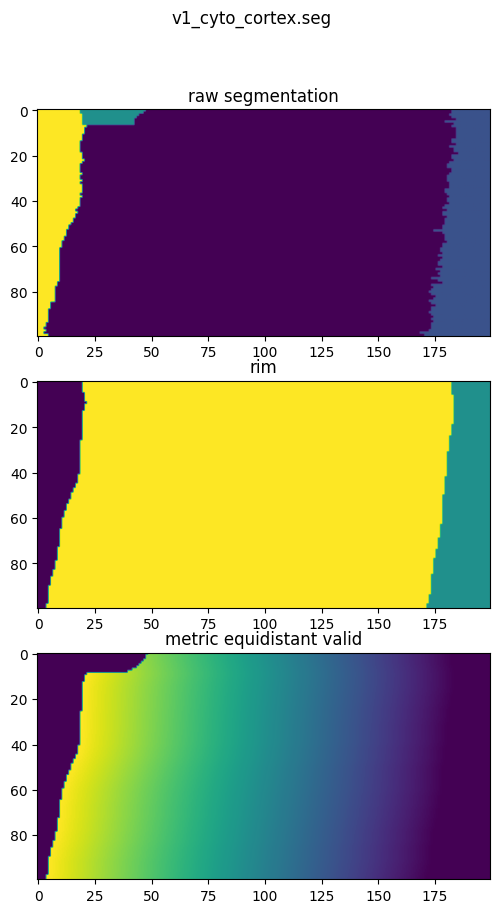

Found previous files: 
	 rim - v2_pp_seg_1_rim.nii
	 metric_equidist_valid - v2_pp_seg_1_metric.equidist.valid.nii
Added entry: v2_cyto_rim

Added entry: v2_cyto_metric.equidist.valid



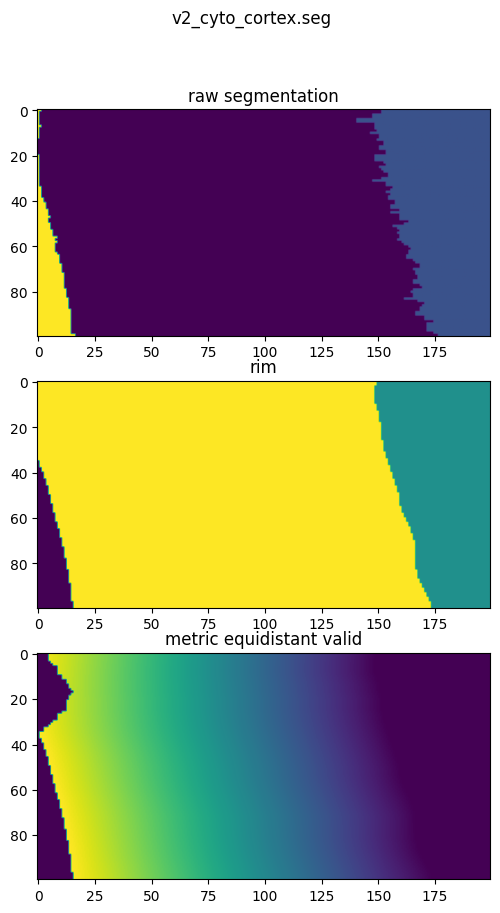

In [42]:
downsampling = [1, 5, 5]
dilation = 5
smoothing = 5
overwrite = False
special = 'metric.equidist.valid'

entry = 'v1_cyto_cortex.seg'
ds.add_rim_and_metric(entry, downsampling, dilation, smoothing, special=special, show=True, overwrite=overwrite)

entry = 'v2_cyto_cortex.seg'
ds.add_rim_and_metric(entry, downsampling, dilation, smoothing, special=special, show=True, overwrite=overwrite);


### Save for Paraview

In [43]:
#def save_for_paraview(data, base_name):
#    im = np.zeros(tuple(np.array(data.shape)+2), dtype=data.dtype)
#    im[1:-1, 1:-1, 1:-1] = data
#    #im = im/np.max(im)
#    #im_rgba = (255*CMRmap(im)).astype(np.uint8)
#    #tifffile.imwrite(base_name + '.tif', 
#    #                 np.stack([im*255, im*255, im*255, im*255], -1).astype(np.uint8), 
#    #                 photometric='rgb', 
#    #                 extrasamples='ASSOCALPHA')
#    tifffile.imwrite(base_name + '_gray.tif', ((im/np.max(im))>0).astype(np.uint8))
#    tifffile.imwrite(base_name + '_metric.tif', im.astype(np.float32))
#    #tifffile.imwrite(base_name + '_rgba.tif', im_rgba, photometric='rgb', extrasamples='ASSOCALPHA')
#

# Cortical depth

# Upsample metric

#### proof of principle

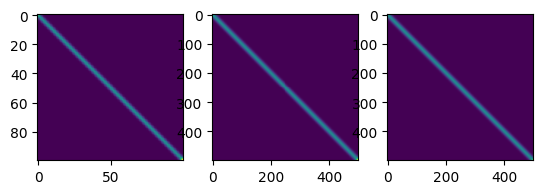

In [44]:
t = np.eye(100).astype('uint8')
t = gaussian(t, 1)
d = da.from_array(t, chunks=(50, 50))

# usual approach fails
# note the artifact in the central plot
# somehow this happend despite the large overlap
overlap_pad = 20
o = da.overlap.overlap(d, depth={0: overlap_pad, 1: overlap_pad}, boundary='reflect')
zoom_factor = 5
def my_zoom(im):
    return zoom(im, (zoom_factor, zoom_factor), order=1, grid_mode=False) # linear
m = o.map_blocks(my_zoom, chunks=tuple(np.array(o.chunksize) * zoom_factor), dtype=np.uint8)
out = da.overlap.trim_overlap(m, 
                              (overlap_pad*zoom_factor, 
                               overlap_pad*zoom_factor, 
                               overlap_pad*zoom_factor), 
                              boundary=(overlap_pad*zoom_factor, 
                                        overlap_pad*zoom_factor, 
                                        overlap_pad*zoom_factor))
out = out.compute()

# dask has a better inbuilt method
adj_zoom_factor = (t.shape[0] * zoom_factor) / (t.shape[0] - 1)
matrix = np.eye(3) / adj_zoom_factor
matrix[-1, -1] = 1
out2 = ndinterp.affine_transform(d, 
                                 matrix=matrix, 
                                 output_shape=tuple(np.array(t.shape) * zoom_factor), 
                                 order=1, 
                                 output_chunks=(100, 100))
out2 = out2.compute()

fig, ax = plt.subplots(1, 3)
ax[0].imshow(d)
ax[1].imshow(out)
ax[2].imshow(out2)

#### Process

In [45]:
real_zoom = 10
output_chunks = [200, 200, 200]
try_read = True
overwritecompute = True
special = 'metric.upsampled'

entry = 'v1_cyto_metric.equidist.valid'
ds.add_zoom(entry, real_zoom, special=special, try_read=try_read, overwritecompute=overwritecompute)

entry = 'v2_cyto_metric.equidist.valid'
ds.add_zoom(entry, real_zoom, special=special, try_read=try_read, overwritecompute=overwritecompute);


Found previous file: v1_pp_seg_1_metric.equidist.valid_metric.upsampled.zarr
Found previous file: v1_pp_seg_1_metric.equidist.valid_metric.upsampled.zarr, NOT USING output_chunks 200
Added entry: v1_cyto_metric.upsampled

Found previous file: v2_pp_seg_1_metric.equidist.valid_metric.upsampled.zarr
Found previous file: v2_pp_seg_1_metric.equidist.valid_metric.upsampled.zarr, NOT USING output_chunks 200
Added entry: v2_cyto_metric.upsampled



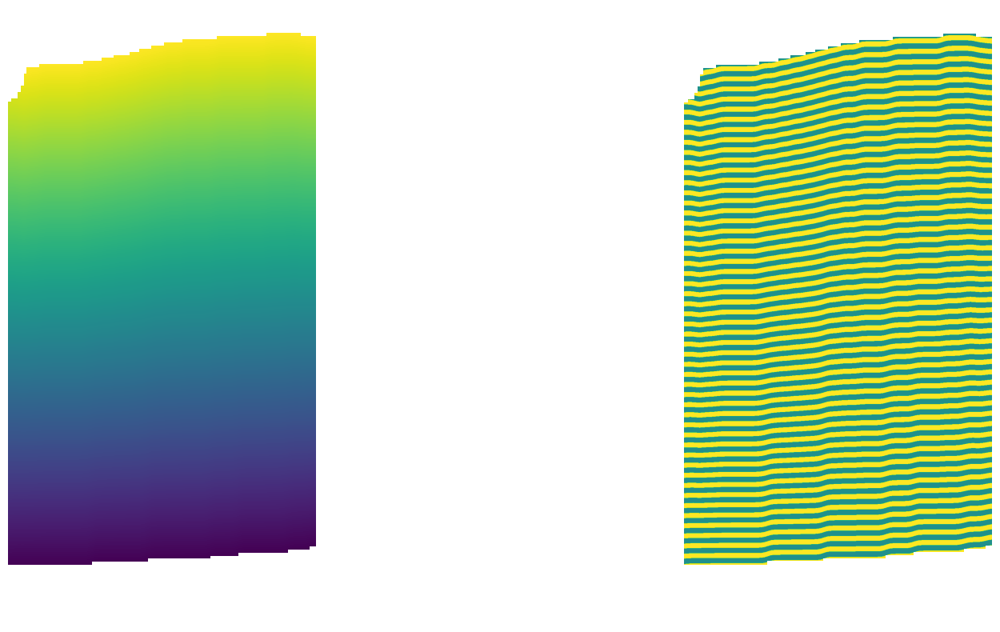

In [46]:
entry = 'v1_cyto_metric.upsampled'
metric = ds.get_data(entry)

depthbins = pdm.get_layers(metric[..., 500], n_depthbins=n_depthbins, min_values_per_layer=1)
pdm_v.plot_upsampled_layers(metric, depthbins, roi=[None, None, 500])

fig.savefig(f'plots/v1_example_{n_depthbins}_layers.png')
fig.savefig(f'plots/v1_example_{n_depthbins}_layers.svg')

# cortical depth in mm

In [47]:
physical_voxel_size_um=[10, 10.3, 10.3]

entry = 'v1_cyto_rim'
rim = ds.get_data(entry)
entry = 'v1_cyto_metric.equidist.valid'
metric = ds.get_data(entry)
average_layer_depths = pdm.get_average_layer_depths(rim, metric, depthbins, physical_voxel_size_um=physical_voxel_size_um)
ds.get_entry(entry)['measurements']['average_layer_depths'] = average_layer_depths.copy()

entry = 'v2_cyto_rim'
rim = ds.get_data(entry)
entry = 'v2_cyto_metric.equidist.valid'
metric = ds.get_data(entry)
average_layer_depths = pdm.get_average_layer_depths(rim, metric, depthbins, physical_voxel_size_um=physical_voxel_size_um)
ds.get_entry(entry)['measurements']['average_layer_depths'] = average_layer_depths.copy()


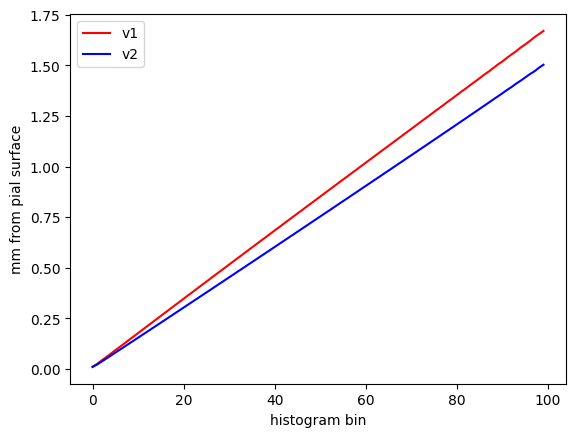

In [48]:
entry = 'v1_cyto_metric.equidist.valid'
average_layer_depths = ds.get_entry(entry)['measurements']['average_layer_depths']
plt.plot(average_layer_depths, 'r', label='v1')

entry = 'v2_cyto_metric.equidist.valid'
average_layer_depths = ds.get_entry(entry)['measurements']['average_layer_depths']
plt.plot(average_layer_depths, 'b', label='v2')

plt.gca().set_ylabel('mm from pial surface')
plt.gca().set_xlabel('histogram bin')
plt.legend()

# Segmentation of perivascular space (Labkit)

In [49]:
# 1) merge angio and (registered) cyto channel
# 2) downsample 3*3*3 via nearest neighbour interpolation
# 3) semi-manually segment large vessels (bright in both channels) 
#    and their perivascular space (dark, especially in the cyto channel) using Labkit
# 4) TODO: morphological filtering (opening to remove small structures)
# 5) upsample the segmentation back to native resolution
# 6) TODO: more morphological filtering (connected component size) rather do this on the final, combined segmentation

#### merge channels and downsample

In [50]:
downsampling = [1, 3, 3, 3]
special = 'strided.downsampled'
try_read = True
overwritecompute = True

entry = 'v1_cyto_reg'
cyto = ds.get_data(entry)
entry = 'v1_angio'
angio = ds.get_data(entry)
composite = da.stack([cyto, angio])
ds.add_strided_downsampling(entry, composite, downsampling, special=special, 
                        try_read=try_read, overwritecompute=overwritecompute)

entry = 'v2_cyto_reg'
cyto = ds.get_data(entry)
entry = 'v2_angio'
angio = ds.get_data(entry)
composite = da.stack([cyto, angio])
ds.add_strided_downsampling(entry, composite, downsampling, special=special, 
                        try_read=try_read, overwritecompute=overwritecompute);


Found previous file: Occlobe10_8_HR_6,3_V1_composite_350-1350_strided.downsampled.zarr
Added entry: v1_angio_strided.downsampled

Found previous file: Occlobe10_8_HR_6,3_V2_composite_200-1200_strided.downsampled.zarr
Added entry: v2_angio_strided.downsampled



#### Segment with Labkit

In [51]:
# Segment large vessels and perivascular space
# (if necessary, postprocess w. morphological operations)
# (if necessary, remove incorrect components w. Napari, using 
#  https://github.com/haesleinhuepf/napari-segment-blobs-and-things-with-membranes)

In [52]:
#data = ds.get_data('v1_angio_Labkit.segmentation')
#
#if not isinstance(data, da.Array):
#    data = da.from_array(data).rechunk((200, 200, 200))
## opening only at the image border
#filt = binary_dilation(binary_erosion(data))
#filt[5:-1, 1:-1, 1:-1] = data[5:-1, 1:-1, 1:-1]
#labels, features = da_label(filt)
#regionprops = pdm.apply_chunked_regionprops(labels)
## component filtering
#include_area_thres = 700
#include = regionprops.loc[regionprops['area'] > include_area_thres, 'label']
#include = np.array(include)
#
#dtype = labels.dtype
#labels_filt = labels.map_blocks(pdm.accept_labels, 
#                                dtype=dtype, 
#                                include=include).compute()
#area_filt = labels_filt > 0

In [53]:
# Load results
resave_mod = {'roi': [[None, 334], 
                      [None, 667], 
                      [None, 667]], 
              'chunk_size': 200}
derivative_config = {'files': {'tif': 'v1_composite_reg_lk_seg_filt_adj.tif'}, 
                     'parent': 'v1_angio', 
                     'region': 'v1', 
                     'channel': 'angio', 
                     'resave_mod': copy.deepcopy(resave_mod), 
                     'special': 'Labkit.segmentation.clean'}
ds.add_derivative(derivative_config)

derivative_config = {'files': {'tif': 'v2_composite_reg_lk_seg3_filt_adj.tif'}, 
                     'parent': 'v2_angio', 
                     'region': 'v2', 
                     'channel': 'angio', 
                     'resave_mod': copy.deepcopy(resave_mod), 
                     'special': 'Labkit.segmentation.clean'}
ds.add_derivative(derivative_config);

Converting v1_angio_Labkit.segmentation.clean to zarr
/tf/angio/v1_composite_reg_lk_seg_filt_adj_angio.zarr already exists, loading from file
Added entry: v1_angio_Labkit.segmentation.clean

Converting v2_angio_Labkit.segmentation.clean to zarr
/tf/angio/v2_composite_reg_lk_seg3_filt_adj_angio.zarr already exists, loading from file
Added entry: v2_angio_Labkit.segmentation.clean



#### Resample the segmentation back to native resolution and save to zarr

In [54]:
real_zoom = 3
output_chunks = [200, 200, 200]
try_read = True
overwritecompute = True
special = 'Labkit.segmentation.upsampled'

postproc_load_mod = {'roi': [[None, 1000], 
                             [None, 2000], 
                             [None, 2000]]}

entry = 'v1_angio_Labkit.segmentation.clean'
new_entry = ds.add_zoom(entry, real_zoom, special=special, try_read=try_read, overwritecompute=overwritecompute)
ds.add_load_mod(new_entry, postproc_load_mod)

entry = 'v2_angio_Labkit.segmentation.clean'
new_entry = ds.add_zoom(entry, real_zoom, special=special, try_read=try_read, overwritecompute=overwritecompute)
ds.add_load_mod(new_entry, postproc_load_mod)

Found previous file: v1_composite_reg_lk_seg_filt_adj_Labkit.segmentation.upsampled.zarr
Found previous file: v1_composite_reg_lk_seg_filt_adj_Labkit.segmentation.upsampled.zarr, NOT USING output_chunks 200
Added entry: v1_angio_Labkit.segmentation.upsampled

Found previous file: v2_composite_reg_lk_seg3_filt_adj_Labkit.segmentation.upsampled.zarr
Found previous file: v2_composite_reg_lk_seg3_filt_adj_Labkit.segmentation.upsampled.zarr, NOT USING output_chunks 200
Added entry: v2_angio_Labkit.segmentation.upsampled



# Evaluate angio segmentations

In [55]:
special = 'label'

for region in ['v1', 'v2']:
    for channel in ['angio']:
        for special_input in ['LoG.segmentation', 
                              'TubeMap.segmentation']:
            entry = '_'.join([region, channel, special_input])
            new_entry = ds.add_label(entry, special='.'.join([special_input, special]))
            
            measure_name = 'regionprops'
            ds.measure_regionprops(new_entry, postfix=measure_name)
            

Found previous file: V1_LoG2_4_binaries_combined_LoG.segmentation.label.zarr
Added entry: v1_angio_LoG.segmentation.label

Found previous file: v1_angio_LoG.segmentation.label_regionprops.csv
Added measurements: regionprops to entry v1_angio_LoG.segmentation.label

Found previous file: /tf/angio/Occlobe10_8_HR_6,3_V1_composite_350-1350_angio_binary_TubeMap.segmentation.label.zarr
Added entry: v1_angio_TubeMap.segmentation.label

Found previous file: v1_angio_TubeMap.segmentation.label_regionprops.csv
Added measurements: regionprops to entry v1_angio_TubeMap.segmentation.label

Found previous file: V2_LoG2_4_binaries_combined_LoG.segmentation.label.zarr
Added entry: v2_angio_LoG.segmentation.label

Found previous file: v2_angio_LoG.segmentation.label_regionprops.csv
Added measurements: regionprops to entry v2_angio_LoG.segmentation.label

Found previous file: /tf/angio/Occlobe10_8_HR_6,3_V2_composite_200-1200_angio_binary_TubeMap.segmentation.label.zarr
Added entry: v2_angio_TubeMap.seg

In [56]:
# Count components, and load for plotting
special = 'label'
measure_name = 'regionprops'

all_regionprops = {}
for region in ['v1', 'v2']:
        for special_input in ['LoG.segmentation', 
                              'TubeMap.segmentation']:
            entry = '_'.join([region, 'angio', '.'.join([special_input, special])])
            regionprops_fn = ds.get_entry(entry)['measurements'][measure_name]
            regionprops = pd.read_csv(regionprops_fn)
            n_components = np.sum(regionprops['area'] >= 100)
            print(f'number of components (>= 100) in region {region}, input {special_input}: {n_components}')
            all_regionprops[entry] = regionprops

number of components (>= 100) in region v1, input LoG.segmentation: 113340
number of components (>= 100) in region v1, input TubeMap.segmentation: 146266
number of components (>= 100) in region v2, input LoG.segmentation: 133927
number of components (>= 100) in region v2, input TubeMap.segmentation: 45344


Loading previously saved figure ...


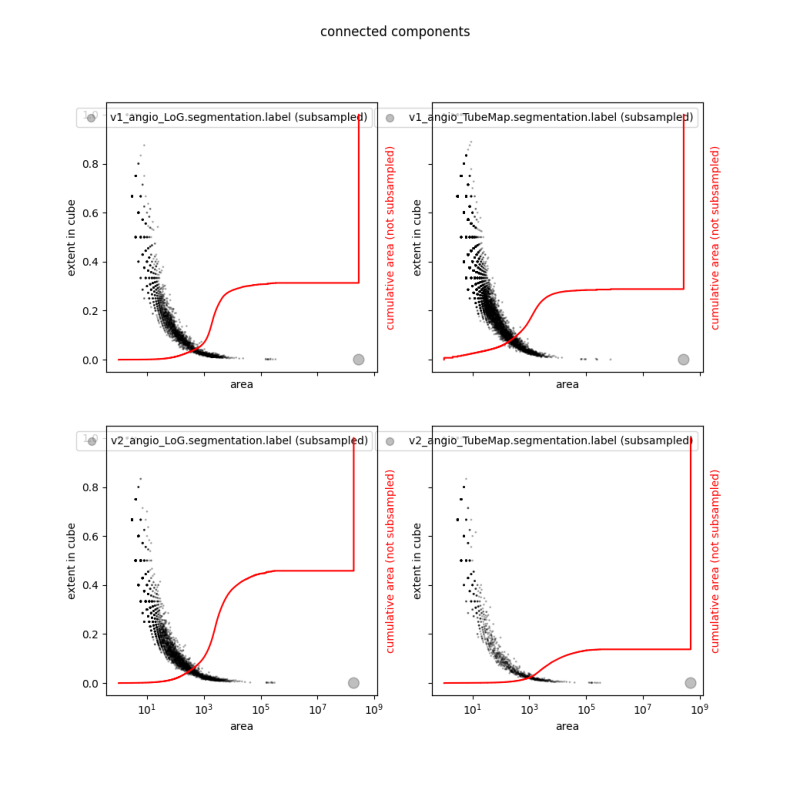

In [57]:
# Plot Components
plot_fn = 'plots/cc_area_vs_extent.png'
plt.rcParams["figure.figsize"] = [10, 10]

if os.path.exists(plot_fn):
    print('Loading previously saved figure ...')
    im = imageio.v2.imread(plot_fn)
    plt.imshow(im)
    plt.gca().axis('off')
    
else:

    fig, ax = plt.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)
    for i, (entry, regionprops) in enumerate(all_regionprops.items()):
        axi = ax[i//2, i%2]
        #if i>=1:
        #    continue
        pdm_v.plot_extent_vs_area(axi, regionprops, entry, areadotsize=True, extent_in_cube=True, cumulative=True)
        
    fig.suptitle('connected components')
    fig.savefig(plot_fn)

In [58]:
del all_regionprops

In [59]:
#for entry, df in all_regionprops.items():
#    print(df.memory_usage(index=True).sum() / 1024**3)

# CC filtering

In [60]:
min_area = 2500
special = 'CCfiltered'

for region in ['v1', 'v2']:
    for special_input in ['LoG.segmentation.label', 
                          'TubeMap.segmentation.label']:
        entry = '_'.join([region, 'angio', special_input])
        new_entry = ds.add_CCfilter(entry, min_area=2500, special='.'.join([special_input, special]))

Found previous file: V1_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered.zarr
Added entry: v1_angio_LoG.segmentation.label.CCfiltered

Found previous file: /tf/angio/Occlobe10_8_HR_6,3_V1_composite_350-1350_angio_binary_TubeMap.segmentation.label_TubeMap.segmentation.label.CCfiltered.zarr
Added entry: v1_angio_TubeMap.segmentation.label.CCfiltered

Found previous file: V2_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered.zarr
Added entry: v2_angio_LoG.segmentation.label.CCfiltered

Found previous file: /tf/angio/Occlobe10_8_HR_6,3_V2_composite_200-1200_angio_binary_TubeMap.segmentation.label_TubeMap.segmentation.label.CCfiltered.zarr
Added entry: v2_angio_TubeMap.segmentation.label.CCfiltered



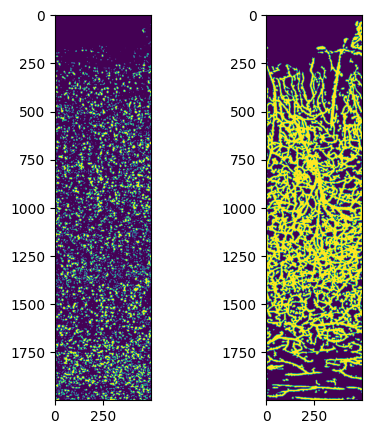

In [61]:
before = 'v1_angio_LoG.segmentation.label'
after = 'v1_angio_LoG.segmentation.label.CCfiltered'
before = ds.get_data(before)
after = ds.get_data(after)

fig, ax = plt.subplots(1, 2, figsize=(5, 5))
roi = tuple([slice(None, 100), 
             slice(None, None), 
             slice(200, 700)])
ax[0].imshow(np.max(before[roi] - after[roi], axis=0) > 0)
ax[1].imshow(np.max(after[roi], axis=0) > 0)

# Inspect

In [62]:
slc = 700
roi = tuple([slice(slc, slc+1), 
            slice(300, 700), 
            slice(700, 1600)])
roi_mip = tuple([slice(slc-50, slc+50), 
                 slice(300, 700), 
                 slice(700, 1600)])

casting from >u2 to uint16


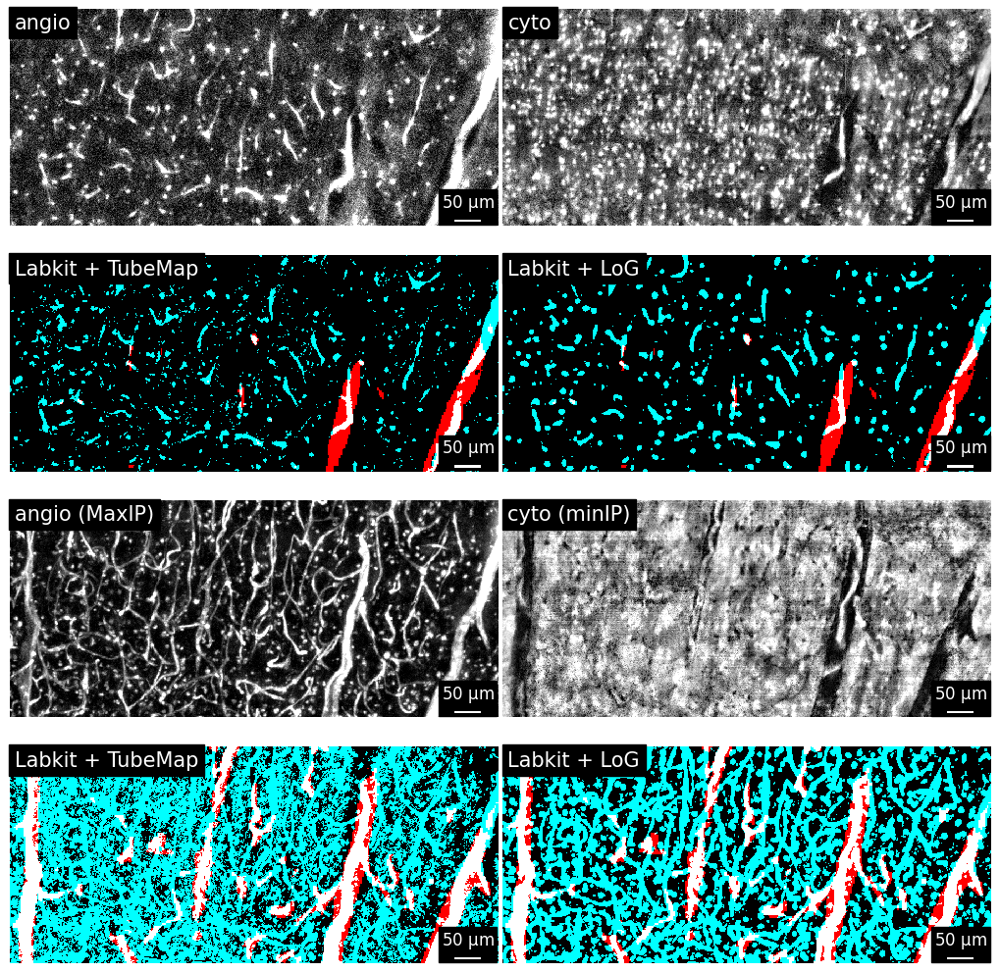

In [63]:
angio = ds.get_data('v1_angio')
cyto = ds.get_data('v1_cyto')
lk = ds.get_data('v1_angio_Labkit.segmentation.upsampled')
log = ds.get_data('v1_angio_LoG.segmentation.label')
tm = ds.get_data('v1_angio_TubeMap.segmentation.label')

panel = pdm_v.inspect_angio_segmentation(angio, cyto, lk, log, tm, roi, roi_mip)

panel.savefig('plots/v1_segmentation_nofilt.png')
panel.savefig('plots/v1_segmentation_nofilt.svg')

casting from >u2 to uint16


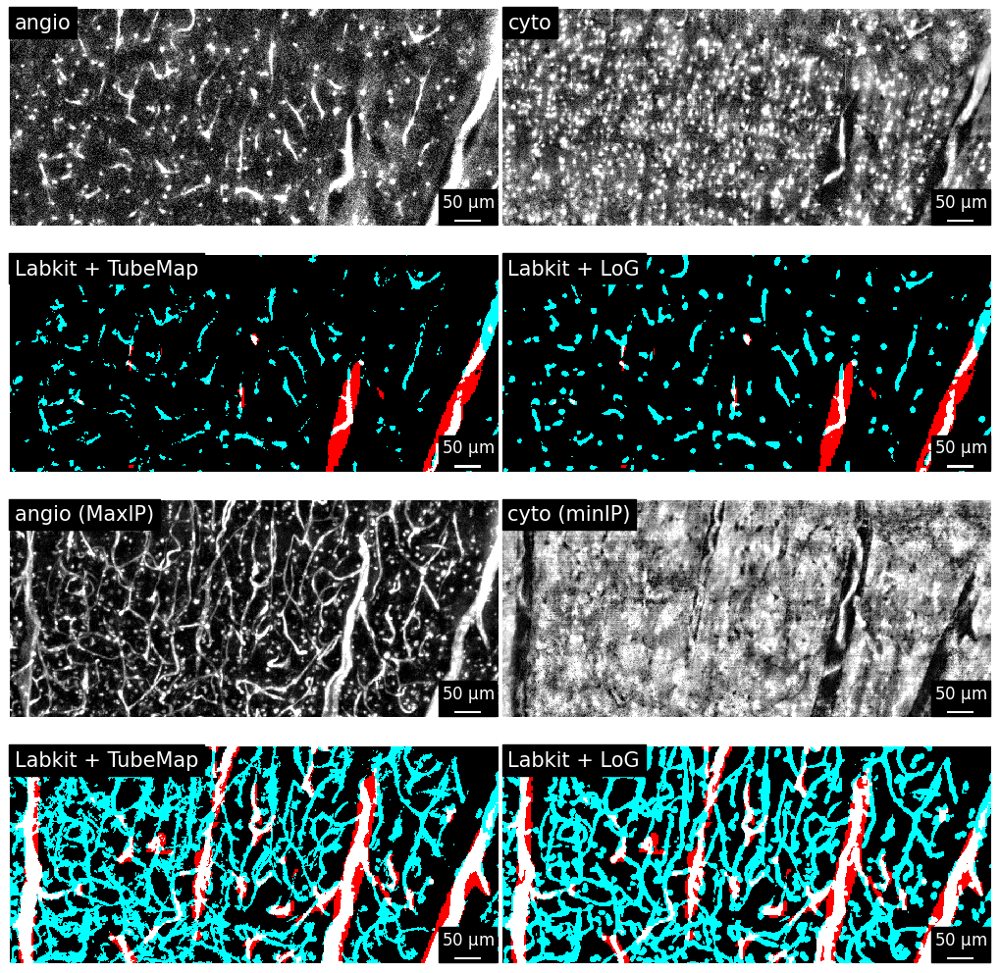

In [64]:
angio = ds.get_data('v1_angio')
cyto = ds.get_data('v1_cyto')
lk = ds.get_data('v1_angio_Labkit.segmentation.upsampled')
log = ds.get_data('v1_angio_LoG.segmentation.label.CCfiltered')
tm = ds.get_data('v1_angio_TubeMap.segmentation.label.CCfiltered')

pdm_v.inspect_angio_segmentation(angio, cyto, lk, log, tm, roi, roi_mip)

panel.savefig('plots/v1_segmentation_CCfilt.png')
panel.savefig('plots/v1_segmentation_CCfilt.svg')

# Combine segmentations

In [65]:
special = 'combined.segmentation'

for region in ['v1', 'v2']:
    p1 = 'LoG.segmentation.label.CCfiltered'
    p2 = 'Labkit.segmentation.upsampled'
    entry_p1 = '_'.join([region, 'angio', p1])
    entry_p2 = '_'.join([region, 'angio', p2])
    new_entry = ds.add_combined_segmentation(entry_p1, entry_p2, special=special)

Found previous file: V1_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered_combined.segmentation.zarr
Added entry: v1_angio_combined.segmentation

Found previous file: V2_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered_combined.segmentation.zarr
Added entry: v2_angio_combined.segmentation



# Apply local thickness transform

In [66]:
depth = (50, 50, 50)
scale = .5
special = 'LTtransform'

for entry in ['v1_angio_combined.segmentation', 
              'v2_angio_combined.segmentation']:
    new_entry = ds.add_lt_transform(entry, depth=depth, scale=scale, special=special)

Found previous file: V1_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered_combined.segmentation_LTtransform.zarr
Added entry: v1_angio_LTtransform

Found previous file: V2_LoG2_4_binaries_combined_LoG.segmentation.label_LoG.segmentation.label.CCfiltered_combined.segmentation_LTtransform.zarr
Added entry: v2_angio_LTtransform



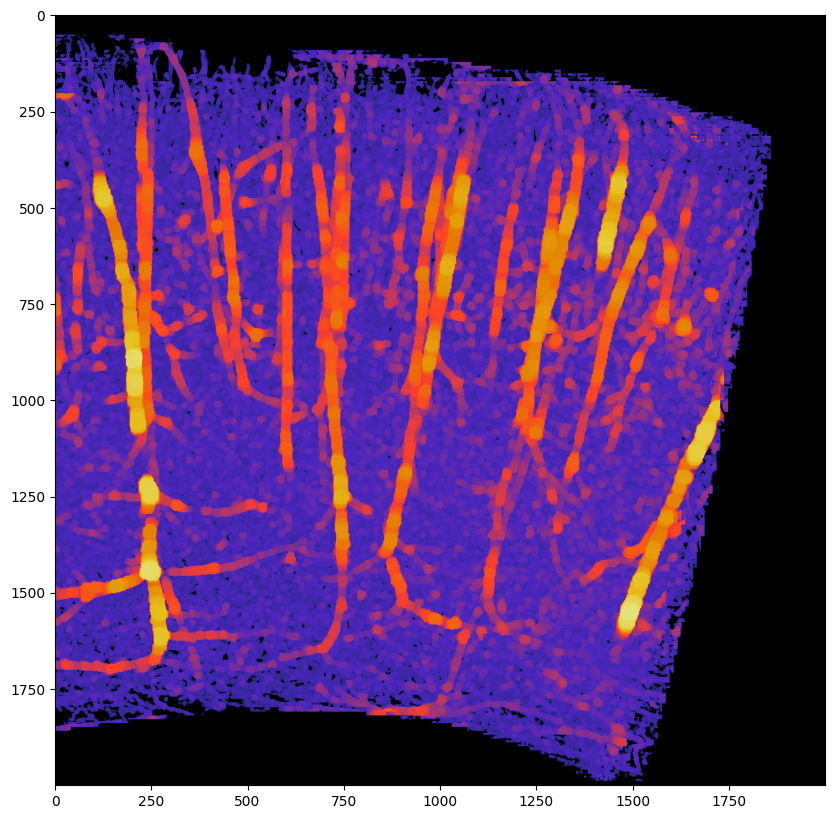

In [67]:
im = ds.get_data('v1_angio_LTtransform')
metric = ds.get_data('v1_cyto_metric.upsampled')
mask = np.isnan(metric)  #np.logical_or(metric <= 0, metric >= 1)
im[mask] = 0
plt.imshow(pdm_u.lazy_chunked_IP(im, axis=0, mode='max').squeeze(), cmap='CMRmap', vmax=25)

# V1 vessel thickness for paraview

In [68]:
#import matplotlib as mpl
#CMRmap = mpl.colormaps['CMRmap']

In [69]:
roi = tuple([slice(699, 951), 
             slice(450, 1700), 
             slice(250, 1500)])

In [70]:
# assemble images for visualization
for_viz_prefix = 'for_visualization'
for_viz = {'im_angio': {'entry': 'v1_angio', 
                        'im': None}, 
           'seg_angio': {'entry': 'v1_angio_combined.segmentation', 
                        'im': None}, 
           'seg_angio_lt': {'entry': 'v1_angio_LTtransform', 
                        'im': None}, 
           'im_cyto': {'entry': 'v1_cyto', 
                        'im': None}, 
           'seg_cyto': {'entry': 'v1_cyto_StarDist.segmentation', 
                        'im': None}, 
           'seg_cyto_lt': {'entry': None, 
                           'im': None}}

for key, item in for_viz.items():
    fn = '_'.join([for_viz_prefix, key + '.zarr'])
    if os.path.exists(fn):
        pass
    elif key == 'seg_cyto_lt':
        seg_cyto = for_viz['seg_cyto']['im'].compute()
        seg_cyto_lt = apply_local_thickness_dahl(seg_cyto>0, scale=.5)
        seg_cyto_lt = da.from_array(seg_cyto_lt)
        seg_cyto_lt = seg_cyto_lt.rechunk((200, 200, 200))
        da.to_zarr(seg_cyto_lt, fn, overwrite=True)
    else:
        im = ds.get_data(item['entry'])[roi]
        im = im.rechunk((200, 200, 200))
        da.to_zarr(im, fn, overwrite=True)
    for_viz[key]['im'] = da.from_zarr(fn)
    print(f'Loaded {key}')

Loaded im_angio
Loaded seg_angio
Loaded seg_angio_lt
Loaded im_cyto
Loaded seg_cyto
Loaded seg_cyto_lt


In [71]:
# preprocess some, and save as .tif
pad_width = 45
for key in ['im_cyto', 'im_angio', 'seg_cyto_lt', 'seg_angio_lt']:
    if key == 'im_cyto':
        fn = '_'.join([for_viz_prefix, key + '.tif'])
        if not os.path.exists(fn):
            im = for_viz[key]['im'].compute().astype(np.uint16)
            # TODO: create 3D wrapper for preproc_cyto_for_vis and preproc_angio_for_vis, also with padding
            im = np.pad(im, ((0, 0), (pad_width, pad_width), (pad_width, pad_width)), mode='edge')
            im = np.stack([pdm_f.preproc_cyto_for_vis(im_i) for im_i in im])
            im = im[:, pad_width:-pad_width, pad_width:-pad_width]
            tifffile.imwrite(fn, im)
    if key == 'im_angio':
        fn = '_'.join([for_viz_prefix, key + '.tif'])
        if not os.path.exists(fn):
            im = for_viz[key]['im'].compute().astype(np.uint16)
            im = np.pad(im, ((0, 0), (pad_width, pad_width), (pad_width, pad_width)), mode='edge')
            im = np.stack([pdm_f.preproc_angio_for_vis(im_i) for im_i in im])
            im = im[:, pad_width:-pad_width, pad_width:-pad_width]
            tifffile.imwrite(fn, im)

    if key in ['seg_cyto_lt', 'seg_angio_lt']:
        # close the segmentation at the sides of the volume
        im[0, ...] = 0
        im[-1, ...] = 0
        im[:, 0, :] = 0
        im[:, -1, :] = 0
        im[..., 0] = 0
        im[..., -1] = 0
        fn = '_'.join([for_viz_prefix, key + '_gray' + '.tif'])  
        if not os.path.exists(fn):
            im = for_viz[key]['im'].compute().astype(np.uint16)
            tifffile.imsave(fn, (im > 0).astype(np.uint8))
        fn = '_'.join([for_viz_prefix, key + '_lt' + '.tif'])  
        if not os.path.exists(fn):
            im = for_viz[key]['im'].compute().astype(np.uint16)
            tifffile.imsave(fn, im)
            
    print(f'{key} file: {fn}')

im_cyto file: for_visualization_im_cyto.tif
im_angio file: for_visualization_im_angio.tif
seg_cyto_lt file: for_visualization_seg_cyto_lt_lt.tif
seg_angio_lt file: for_visualization_seg_angio_lt_lt.tif


In [72]:
#pad_width = 45
#im = for_viz['im_angio']['im'][50, ...].compute()
#im_pp = pdm_f.preproc_angio_for_vis(np.pad(im, ((pad_width, pad_width), (pad_width, pad_width)), mode='reflect'))
#im_pp = im_pp[pad_width:-pad_width, pad_width:-pad_width]

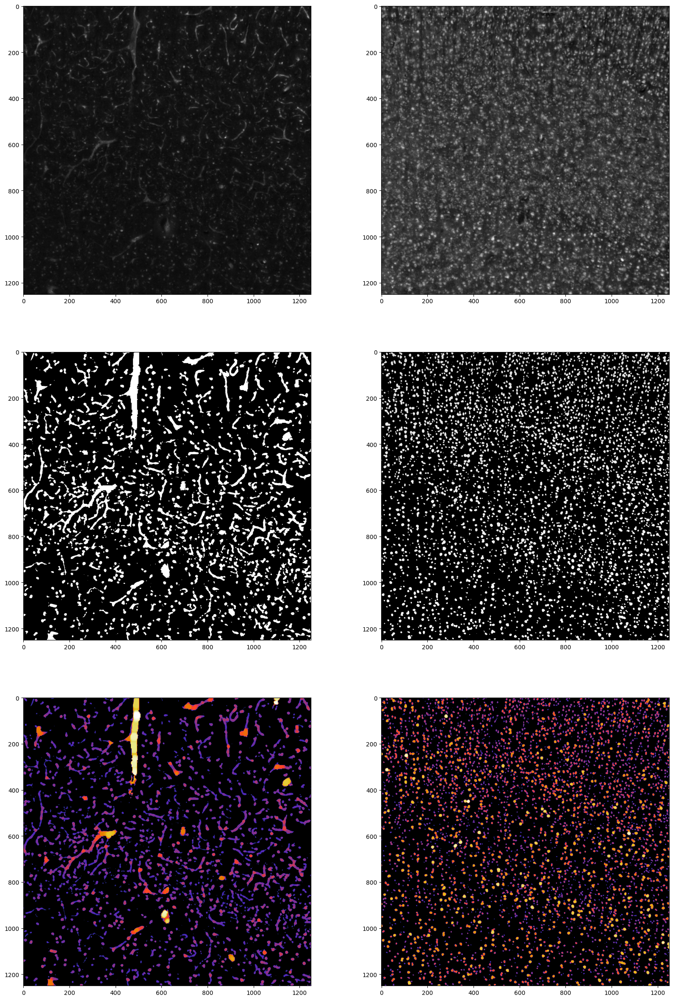

In [73]:
fig, ax = plt.subplots(3, 2, figsize=(20, 30))

slc, maxr = 50, 5

im = np.max(tifffile.memmap('for_visualization_im_angio.tif')[slc-maxr:slc+maxr, ...], axis=0)
ax[0, 0].imshow(im, cmap='gray')
im = np.max(for_viz['seg_angio']['im'][slc-maxr:slc+maxr, ...], axis=0)
ax[1, 0].imshow(im, cmap='gray')
im = np.max(for_viz['seg_angio_lt']['im'][slc-maxr:slc+maxr, ...], axis=0)
ax[2, 0].imshow(im, cmap='CMRmap')

im = np.max(tifffile.memmap('for_visualization_im_cyto.tif')[slc-maxr:slc+maxr, ...], axis=0)
ax[0, 1].imshow(im, cmap='gray')
im = np.max(for_viz['seg_cyto']['im'][slc-maxr:slc+maxr, ...], axis=0)
ax[1, 1].imshow(im, cmap='gray')
im = np.max(for_viz['seg_cyto_lt']['im'][slc-maxr:slc+maxr, ...], axis=0)
ax[2, 1].imshow(im, cmap='CMRmap')


In [74]:
# The strategy used here is slighly different than proposed by Dahl
# I could not get Paraview to display the colors in the rgba.tiff 
# (it always took one channel and mapped those intensities to a colormap)
# So, it is easier to not use an rgba.tiff but 1) a single-channel gray.tif (the segmentation) and
# 2) a single-channel local-thickness.tif

In [75]:
# Write CMPmap to an .xml that Paraview can read
# see https://github.com/kthyng/cmocean-paraview/blob/master/xml/algae.xml
#import matplotlib as mpl
#CMRmap = mpl.colormaps['CMRmap']
#with open('CMRmap.txt', 'w') as f:
#    f.write('<ColorMaps> \n')
#    f.write('<ColorMap name="CMRmap" space="RGB"> \n')
#    for i, j in enumerate(range(CMRmap.N)):
#        r, g, b, a = CMRmap(i)
#        f.write('<Point x="' + str(i/CMRmap.N) + '" o="' + str(a) + '" r="' + str(r) + '" g="' + str(g) + '" b="' + str(b) + '"/> \n')
#    f.write('</ColorMap> \n')
#    f.write('</ColorMaps> \n')

# Compute angio density

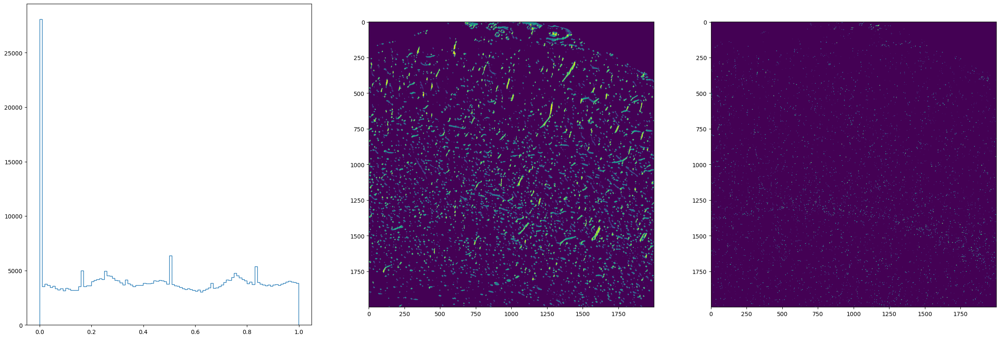

In [95]:
# NOTE: the spike at zero
# we avoid counting it below (see delta)
data_name = 'v1_angio_orientation.hsv'
data = ds.get_data(data_name)
data = data[..., 0]
im = data[500, ...].compute()
#im = .5 - np.abs(im - .5)

mask_name = 'v1_angio_LoG.segmentation'
mask = ds.get_data(mask_name)
mask = mask[500, ...].compute()
#im = np.ma.masked_array(im, mask=np.logical_not(mask))

fig, ax = plt.subplots(1, 3, figsize=(30, 10))
ax[0].hist(im[mask>0], bins=100, histtype='step');
ax[1].imshow(im)
ax[2].imshow(np.logical_and(im==0, mask>0))
#ax[1].imshow(np.logical_and(np.logical_and(im>0, im<0.05), mask>0))

In [103]:
%%time

entry = 'v1_cyto_metric.upsampled'
metric = ds.get_data(entry)

depthbins = pdm.get_layers(metric[..., 500], n_depthbins=n_depthbins, min_values_per_layer=1)
depthbins = depthbins[::-1]

for region in ['v1', 'v2']:
    data_name = region + '_angio_orientation.hsv'
    index_name = region + '_cyto_metric.upsampled'
    mask_name = region + '_angio_LoG.segmentation'
    depthbins = depthbins

    special = 'orientation.density'
    pre_chunk = (10, 2000, 2000)
    pre_slice = tuple([slice(None, None, 1),  # TODO revert to 1, 1, 1
                       slice(None, None, 1), 
                       slice(None, None, 1)])
    hsv_data = True
    wrap_orientation = True
    binary_data = False

    delta = 0.0001
    if wrap_orientation:
        databins = pdm.get_bins(0+delta, 1/2, 1/180)
    else:
        databins = pdm.get_bins(0+delta, 1, 1/180)

    data = ds.measure_density(data_name, index_name, depthbins, databins=databins, 
                              pre_chunk=pre_chunk, pre_slice=pre_slice, hsv_data=hsv_data, 
                              wrap_orientation=wrap_orientation, mask_name=mask_name, 
                              binary_data=binary_data, special=special)

Found previous file: v1_angio_orientation.hsv_orientation.density.csv
Added measurements: orientation.density to entry v1_angio_orientation.hsv

Found previous file: v1_angio_orientation.hsv_orientation.density_pp.csv and v1_angio_orientation.hsv_orientation.density_pv.csv and v1_angio_orientation.hsv_orientation.density_pc.csv
Added measurements: orientation.density_pp to entry v1_angio_orientation.hsv

Added measurements: orientation.density_pv to entry v1_angio_orientation.hsv

Added measurements: orientation.density_pc to entry v1_angio_orientation.hsv

Could not find previous file: v2_angio_orientation.hsv_orientation.density.csv, computing ...
Assuming hsv data: extracting h (the first dim along the last axis) ...
Wrapping orientation: moving the discontinuity from vertical (0) to horizontal (.5) ...
Data after pre_chunk and/or pre_slice:


dask.array<rechunk-merge, shape=(1000, 2000, 2000), dtype=float64, chunksize=(10, 2000, 2000), chunktype=numpy.MaskedArray>

Index after pre_chunk and/or pre_slice:


dask.array<rechunk-merge, shape=(1000, 2000, 2000), dtype=float32, chunksize=(10, 2000, 2000), chunktype=numpy.ndarray>

Added measurements: orientation.density to entry v2_angio_orientation.hsv

Could not find previous file: v2_angio_orientation.hsv_orientation.density_pp.csv, computing ...
Added measurements: orientation.density_pp to entry v2_angio_orientation.hsv

Added measurements: orientation.density_pv to entry v2_angio_orientation.hsv

Added measurements: orientation.density_pc to entry v2_angio_orientation.hsv

CPU times: user 14min 22s, sys: 6min 40s, total: 21min 2s
Wall time: 2min 56s


In [102]:
#!rm 'v1_angio_orientation.hsv_orientation.density.csv'
#!rm 'v1_angio_orientation.hsv_orientation.density_pp.csv'
#!rm 'v1_angio_orientation.hsv_orientation.density_pv.csv'
#!rm 'v1_angio_orientation.hsv_orientation.density_pc.csv'

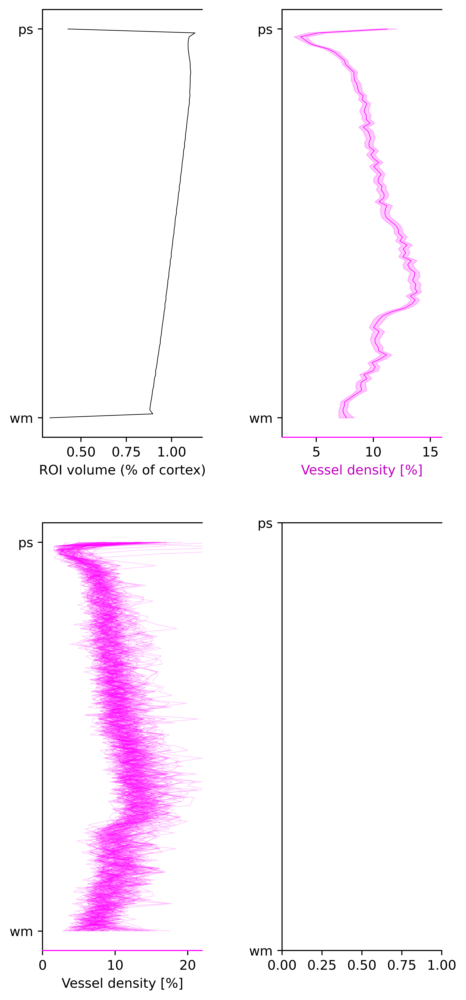

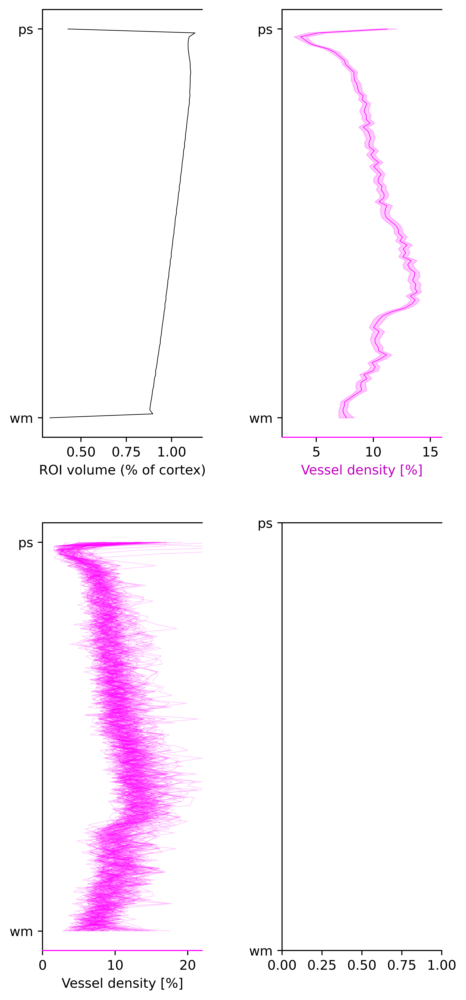

In [104]:
# NOTE: Do NOT use - this is the LoG segmentation only
data_name = 'v1_angio_orientation.hsv'

#angio_density = ds.get_measurements(data_name)['density']
#angio_density = pd.read_csv(angio_density)
angio_density_pp = ds.get_measurements(data_name)['orientation.density_pp']
angio_density_pp = pd.read_csv(angio_density_pp)
#angio_density_pv = ds.get_measurements(data_name)['density_pv']
#angio_density_pv = pd.read_csv(angio_density_pv)
angio_density_pc = ds.get_measurements(data_name)['orientation.density_pc']
angio_density_pc = pd.read_csv(angio_density_pc)

pdm_v.depthplot_density(angio_pp=angio_density_pp, angio_pc=angio_density_pc, scale_sem=2)

# Orientation plot

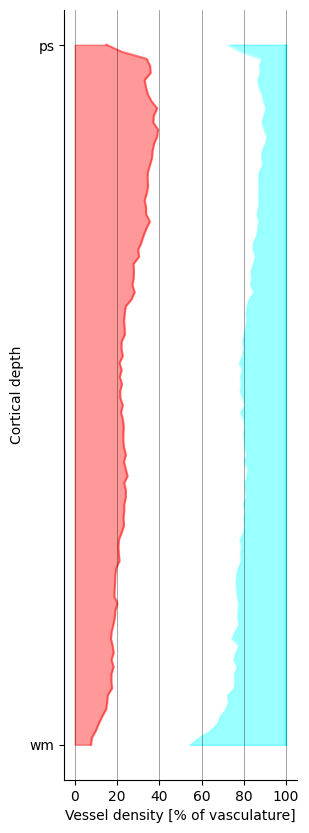

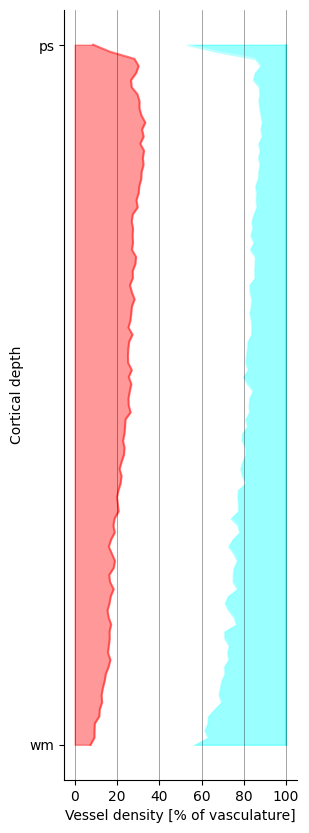

In [129]:
for region in ['v1', 'v2']:
    data_name = region + '_angio_orientation.hsv'

    angio_density = ds.get_measurements(data_name)['orientation.density']
    angio_density = pd.read_csv(angio_density)
    angio_density_pp = ds.get_measurements(data_name)['orientation.density_pp']
    angio_density_pp = pd.read_csv(angio_density_pp)
    angio_density_pv = ds.get_measurements(data_name)['orientation.density_pv']
    angio_density_pv = pd.read_csv(angio_density_pv)
    angio_density_pc = ds.get_measurements(data_name)['orientation.density_pc']
    angio_density_pc = pd.read_csv(angio_density_pc)
    
    wrap_orientation = True
    if wrap_orientation:
        databins = pdm.get_bins(0, 1/2, 1/180)
    else:
        databins = pdm.get_bins(0, 1, 1/180)
    
    orientation_bins = np.array([0, 20, 70, 90])
    orientation_bins = orientation_bins / 180
    c = [(1, 0, 0, 1), 
         (1, 1, 1, 1), 
         (0, 1, 1, 1)]

    fig = pdm_v.stacked_depthplot_density(angio_density_pv, databins, normalize=True, 
                                          bins=orientation_bins, colors=c)
    
    fig.savefig(f'plots/{region}_stacked_depthplot_density.png')

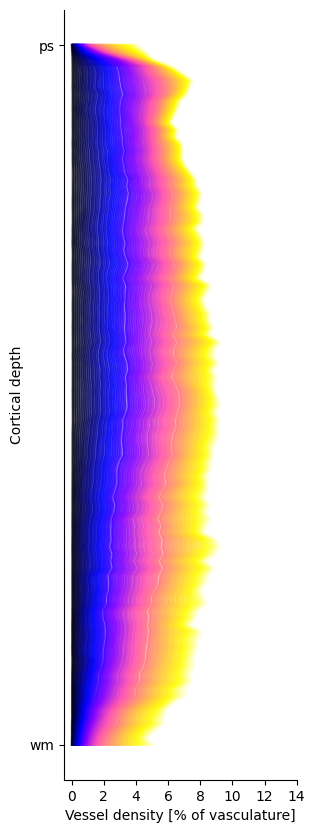

In [107]:
fig = pdm_v.stacked_depthplot_density(angio_density_pv, databins)

# Place cellcenters in volume

In [108]:
# NOTE: For a simple histogram of cells across cortical depth, this would not be efficient
# because we could just use the positions to extract their depth (i.e. we would not need to work with the data-volume)
# However, for density calculations this still makes sense 
# (as we anyways need to work with the data-volume to get a histogram of the background)
special = 'cellcenters'

for entry, mask_entry in [['v1_cyto_StarDist.segmentation', 'v1_angio_combined.segmentation'], 
                          ['v2_cyto_StarDist.segmentation', 'v2_angio_combined.segmentation']]:
    ds.cellcenters_to_volume(entry, mask_name=mask_entry, mask_label=True, special=special)

Found previous files: v1_cyto_StarDist.segmentation_cellcenters.zarr
Found previous files: v1_cyto_StarDist.segmentation_cellcenters.masked.label.zarr
Added entry: v1_cyto_cellcenters

Added entry: v1_cyto_cellcenters.masked.label

Found previous files: v2_cyto_StarDist.segmentation_cellcenters.zarr
Found previous files: v2_cyto_StarDist.segmentation_cellcenters.masked.label.zarr
Added entry: v2_cyto_cellcenters

Added entry: v2_cyto_cellcenters.masked.label



In [109]:
#p = np.mean(ds.get_data('v1_cyto_cellcenters'), axis=(0, 2)).compute()
#p = scipy.ndimage.uniform_filter1d(p, 30)
#physical_pixel_size_um = (1.03 * 1.03 * 1)
#plt.plot(p * (physical_pixel_size_um * 1000**3) / 10**3) 

In [110]:
#cellcenters = ds.get_entry('v1_cyto_StarDist.segmentation')['measurements']['points'].copy()
#print(cellcenters.shape)

In [111]:
#np.sum(ds.get_data('v1_cyto_cellcenters')).compute()

In [112]:
#data_name = 'v1_cyto_cellcenters'
#cyto_density = ds.get_measurements(data_name)['density']
#cyto_density = pd.read_csv(cyto_density)
#cyto_density.loc[cyto_density['value']==1, 'count'].sum()

In [113]:
#fig, ax = plt.subplots(1, 3, figsize=(10, 3))
#ax[0].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters'), axis=0, mode='max').squeeze(), cmap='binary')
#ax[1].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters'), axis=1, mode='max').squeeze(), cmap='binary')
#ax[2].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters'), axis=2, mode='max').squeeze(), cmap='binary')

In [114]:
#fig, ax = plt.subplots(1, 3, figsize=(10, 3))
#ax[0].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label'), axis=0, mode='max').squeeze(), cmap='binary')
#ax[1].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label'), axis=1, mode='max').squeeze(), cmap='binary')
#ax[2].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label'), axis=2, mode='max').squeeze(), cmap='binary')

In [115]:
#fig, ax = plt.subplots(1, 3, figsize=(10, 3))
#ax[0].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label')>0, axis=0, mode='sum').squeeze(), cmap='binary')
#ax[1].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label')>0, axis=1, mode='sum').squeeze(), cmap='binary')
#ax[2].imshow(pdm_u.lazy_chunked_IP(ds.get_data('v1_cyto_cellcenters.masked.label')>0, axis=2, mode='sum').squeeze(), cmap='binary')

# Compute cyto cell-density

In [116]:
%%time

entry = 'v1_cyto_metric.upsampled'
metric = ds.get_data(entry)
mask_name = None
depthbins = pdm.get_layers(metric[..., 500], n_depthbins=n_depthbins, min_values_per_layer=1)[::-1]

special = 'density'
pre_chunk = (10, 2000, 2000)
# NOTE: StarDist labels can be oddly regular at times
# e.g. with cell-centers being restricted to every 4th slice along the z axis
pre_slice = tuple([slice(None, None, 1),  # TODO revert to 1, 1, 1
                   slice(None, None, 1), 
                   slice(None, None, 1)])

for region in ['v1', 'v2']:
    data_name = region + '_cyto_cellcenters'#'v1_cyto_cellcenters'
    index_name = region + '_cyto_metric.upsampled'

    hsv_data = False
    wrap_orientation = False
    binary_data = True

    databins = None

    ds.measure_density(data_name, index_name, depthbins, databins=databins, 
                       pre_chunk=pre_chunk, pre_slice=pre_slice, hsv_data=hsv_data, 
                       wrap_orientation=wrap_orientation, mask_name=mask_name, 
                       binary_data=binary_data, special=special)

Found previous file: v1_cyto_cellcenters_density.csv
Added measurements: density to entry v1_cyto_cellcenters

Found previous file: v1_cyto_cellcenters_density_pp.csv and v1_cyto_cellcenters_density_pv.csv and v1_cyto_cellcenters_density_pc.csv
Added measurements: density_pp to entry v1_cyto_cellcenters

Added measurements: density_pv to entry v1_cyto_cellcenters

Added measurements: density_pc to entry v1_cyto_cellcenters

Found previous file: v2_cyto_cellcenters_density.csv
Added measurements: density to entry v2_cyto_cellcenters

Found previous file: v2_cyto_cellcenters_density_pp.csv and v2_cyto_cellcenters_density_pv.csv and v2_cyto_cellcenters_density_pc.csv
Added measurements: density_pp to entry v2_cyto_cellcenters

Added measurements: density_pv to entry v2_cyto_cellcenters

Added measurements: density_pc to entry v2_cyto_cellcenters

CPU times: user 1.61 s, sys: 580 ms, total: 2.19 s
Wall time: 340 ms


In [117]:
#! rm v2_cyto_cellcenters_density.csv
#! rm v2_cyto_cellcenters_density_pp.csv 
#! rm v2_cyto_cellcenters_density_pv.csv
#! rm v2_cyto_cellcenters_density_pc.csv 

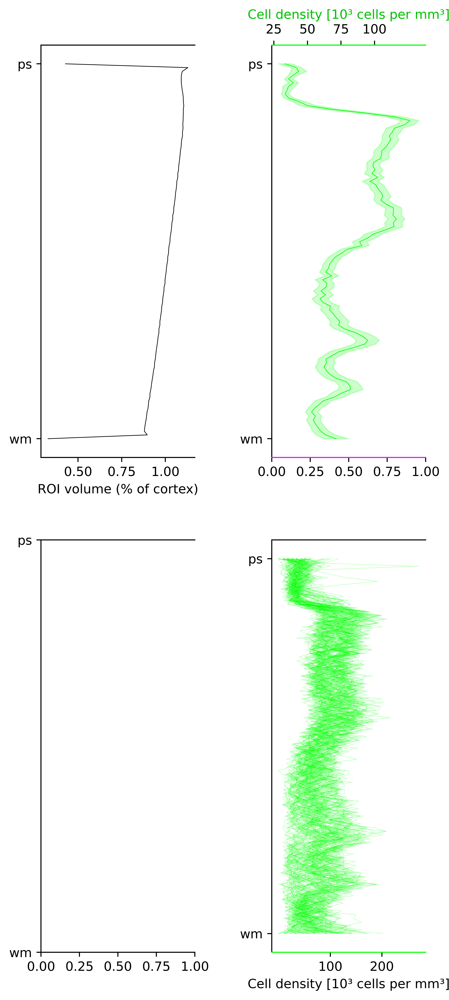

In [119]:
data_name = 'v1_cyto_cellcenters'

#cyto_density = ds.get_measurements(data_name)['density']
#cyto_density = pd.read_csv(cyto_density)
cyto_density_pp = ds.get_measurements(data_name)['density_pp']
cyto_density_pp = pd.read_csv(cyto_density_pp)
#cyto_density_pv = ds.get_measurements(data_name)['density_pv']
#cyto_density_pv = pd.read_csv(cyto_density_pv)
cyto_density_pc = ds.get_measurements(data_name)['density_pc']
cyto_density_pc = pd.read_csv(cyto_density_pc)

fig = pdm_v.depthplot_density(cyto_pp=cyto_density_pp, cyto_pc=cyto_density_pc, scale_sem=2)

In [120]:
# NOTE: for orientation, its correct to use _angio_LoG.segmentation
# BUT DONT USE THIS FOR THE GENERAL DENSITY PLOT - use _angio_combined.segmentation

# radius

In [121]:
entry = 'v1_cyto_metric.upsampled'
metric = ds.get_data(entry)
mask_name = None
depthbins = pdm.get_layers(metric[..., 500], n_depthbins=n_depthbins, min_values_per_layer=1)[::-1]

In [122]:
%%time

for region in ['v1', 'v2']:
    data_name = region + '_angio_LTtransform'
    index_name = region + '_cyto_metric.upsampled'
    mask_name = region + '_angio_combined.segmentation'
    depthbins = depthbins

    special = 'LT.density'
    pre_chunk = (10, 2000, 2000)
    pre_slice = tuple([slice(None, None, 1),  # TODO revert to 1, 1, 1
                       slice(None, None, 1), 
                       slice(None, None, 1)])

    binary_data = False

    databins = pdm.get_bins(0, 40, 1)

    data = ds.measure_density(data_name, index_name, depthbins, databins=databins, 
                              pre_chunk=pre_chunk, pre_slice=pre_slice, 
                              mask_name=mask_name, 
                              binary_data=binary_data, special=special)

Found previous file: v1_angio_LTtransform_LT.density.csv
Added measurements: LT.density to entry v1_angio_LTtransform

Found previous file: v1_angio_LTtransform_LT.density_pp.csv and v1_angio_LTtransform_LT.density_pv.csv and v1_angio_LTtransform_LT.density_pc.csv
Added measurements: LT.density_pp to entry v1_angio_LTtransform

Added measurements: LT.density_pv to entry v1_angio_LTtransform

Added measurements: LT.density_pc to entry v1_angio_LTtransform

Found previous file: v2_angio_LTtransform_LT.density.csv
Added measurements: LT.density to entry v2_angio_LTtransform

Found previous file: v2_angio_LTtransform_LT.density_pp.csv and v2_angio_LTtransform_LT.density_pv.csv and v2_angio_LTtransform_LT.density_pc.csv
Added measurements: LT.density_pp to entry v2_angio_LTtransform

Added measurements: LT.density_pv to entry v2_angio_LTtransform

Added measurements: LT.density_pc to entry v2_angio_LTtransform

CPU times: user 293 ms, sys: 17.1 ms, total: 311 ms
Wall time: 323 ms


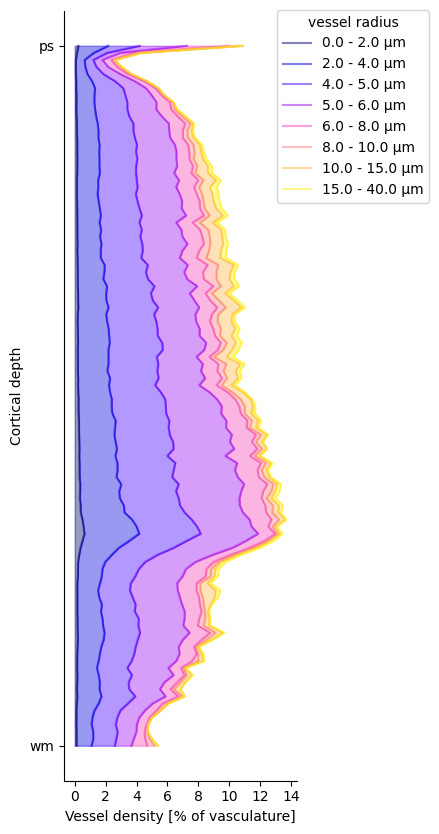

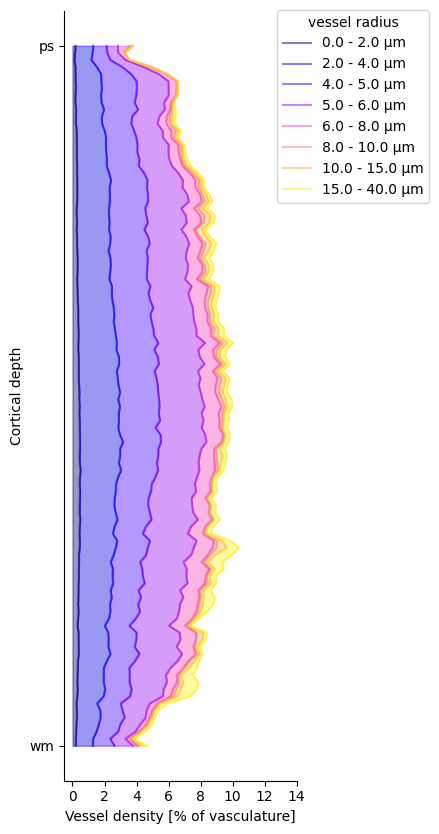

In [123]:
for region in ['v1', 'v2']:
    
    data_name = region + '_angio_LTtransform'

    angio_density = ds.get_measurements(data_name)['LT.density']
    angio_density = pd.read_csv(angio_density)
    angio_density_pp = ds.get_measurements(data_name)['LT.density_pp']
    angio_density_pp = pd.read_csv(angio_density_pp)
    angio_density_pv = ds.get_measurements(data_name)['LT.density_pv']
    angio_density_pv = pd.read_csv(angio_density_pv)
    angio_density_pc = ds.get_measurements(data_name)['LT.density_pc']
    angio_density_pc = pd.read_csv(angio_density_pc)
    
    LT_bins = np.array([0, 2, 4, 5, 6, 8, 10, 15, 40])

    fig = pdm_v.stacked_depthplot_density(angio_density_pv, databins, bins=LT_bins, legend=True)
    
    fig.savefig(f'{region}_stacked_depthplot_density.png')

# Manual layer definition

Added measurements: manual.layers to entry v1_cyto_metric.upsampled

Added measurements: manual.layers to entry v2_cyto_metric.upsampled



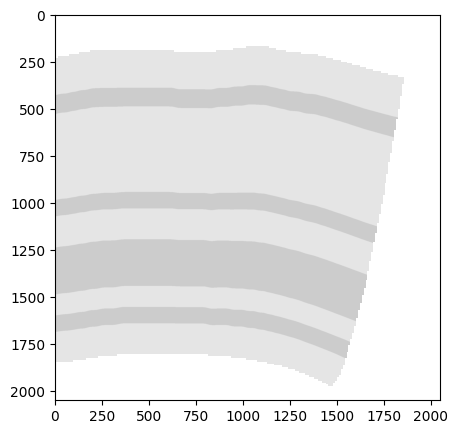

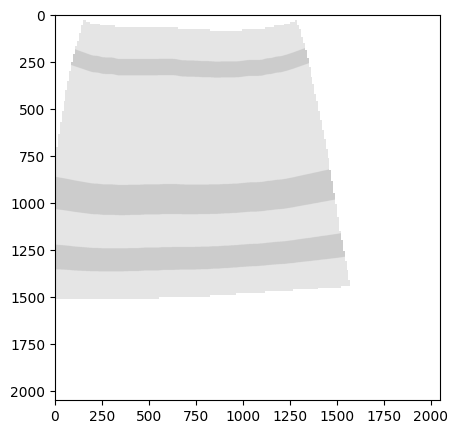

In [124]:
manual_layer_im_fns = ['manual_layer_def/new/v1_layers.PNG', 
                       'manual_layer_def/new/v2_layers.PNG']
manual_layer_boundaries_fns = ['manual_layer_def/new/v1_layers2.0.PNG.labeling', 
                               'manual_layer_def/new/v2_layers2.0.PNG.labeling']
manual_layer_names = [['I', 'II', 'III', 'IVa', 'IVb', 'IVc', 'V', 'VIa', 'VIb'], 
                      ['I', 'II', 'III', 'IV', 'V', 'VIa', 'VIb']]


for region, mlif, mlbf, mln in zip(['v1', 'v2'], 
                                   manual_layer_im_fns, 
                                   manual_layer_boundaries_fns, 
                                   manual_layer_names):
    index_name = region + '_cyto_metric.upsampled'
    cyto_name = region + '_cyto'
    
    mip_roi = tuple([slice(160, 190, None), 
                     slice(None, None, None), 
                     slice(None, None, None)])
    
    lr_index_name = region + '_cyto_metric.equidist.valid'
    rim_name = region + '_cyto_rim'
    
    lr_physical_voxel_size_um = [10, 10.3, 10.3]
    
    manual_layer_im_fn = mlif#'manual_layer_def/new/v1_layers.PNG'
    manual_layer_boundaries_fn = mlbf#'manual_layer_def/new/v1_layers2.0.PNG.labeling'
    manual_layer_names = mln#['I', 'II', 'III', 'IVa', 'IVb', 'IVc', 'V', 'VIa', 'VIb']

    pad = (0, 48, 0, 48)

    ds.add_manual_layer_measurement(index_name, cyto_name, mip_roi, 
                                    lr_index_name, rim_name, 
                                    lr_physical_voxel_size_um, 
                                    manual_layer_im_fn, 
                                    manual_layer_boundaries_fn, 
                                    manual_layer_names, pad, 
                                    special='manual.layers')

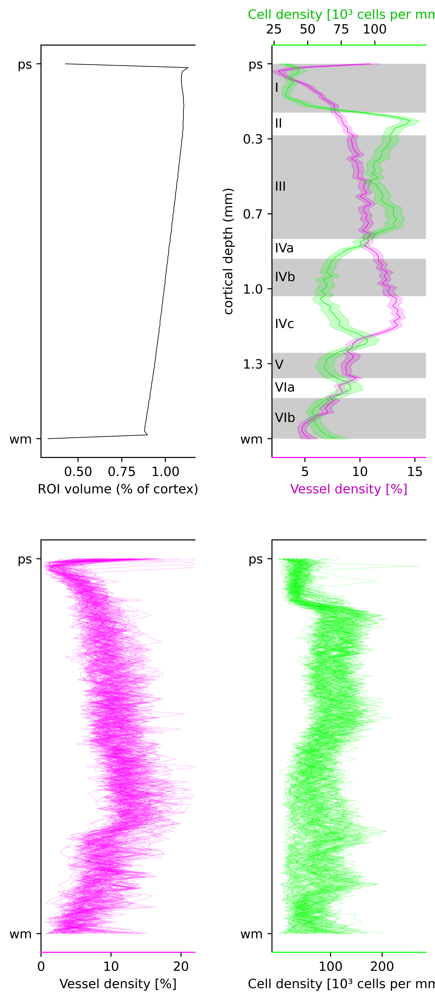

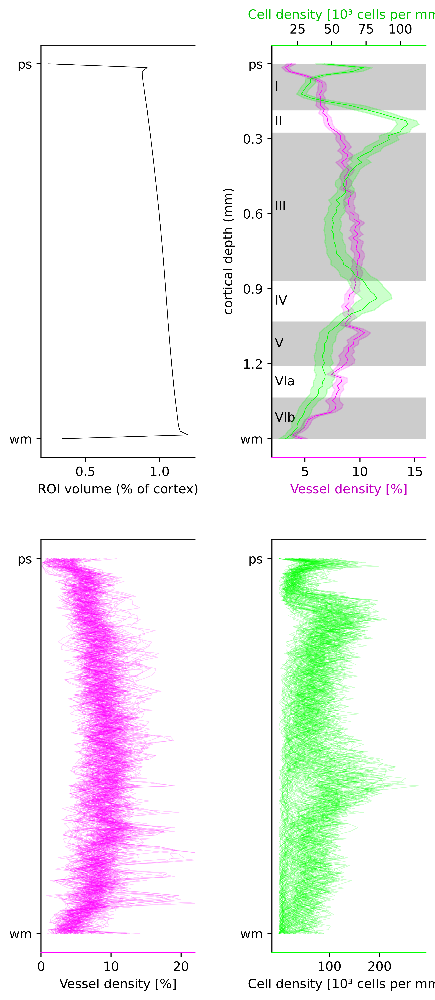

In [125]:
for region in ['v1', 'v2']:
    index_name = region + '_cyto_metric.upsampled'
    manual_layers = ds.get_entry(index_name)['measurements']['manual.layers']
    manual_layer_boundaries_Rdepth = manual_layers['manual_layer_boundary_Rdepths']
    manual_layer_names = manual_layers['manual_layer_names']
    depth_indicator_Rdepths = manual_layers['depth_indicator_Rdepths']
    depth_indicator_Pdepths = manual_layers['depth_indicator_Pdepths']
    peak_df = {'peak': depth_indicator_Rdepths, 
               'label': depth_indicator_Pdepths, 
               'color': [[0, 0, 0, 1] for i in depth_indicator_Pdepths]}
    
    data_name = region + '_angio_LTtransform'
    angio_density_pp = ds.get_measurements(data_name)['LT.density_pp']
    angio_density_pp = pd.read_csv(angio_density_pp)
    angio_density_pc = ds.get_measurements(data_name)['LT.density_pc']
    angio_density_pc = pd.read_csv(angio_density_pc)

    data_name = region + '_cyto_cellcenters'
    cyto_density_pp = ds.get_measurements(data_name)['density_pp']
    cyto_density_pp = pd.read_csv(cyto_density_pp)
    cyto_density_pc = ds.get_measurements(data_name)['density_pc']
    cyto_density_pc = pd.read_csv(cyto_density_pc)

    fig = pdm_v.depthplot_density(angio_pp=angio_density_pp, angio_pc=angio_density_pc, 
                                    cyto_pp=cyto_density_pp, cyto_pc=cyto_density_pc, 
                                    scale_sem=2, 
                                    manual_layer_boundaries=manual_layer_boundaries_Rdepth, 
                                    manual_layer_names=manual_layer_names, 
                                    peak_df=peak_df)
    
    plt.savefig(f'{region}_depthplot_density.png')

# Across area plots

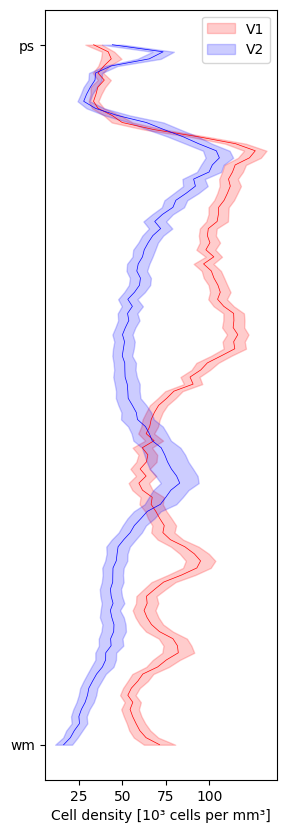

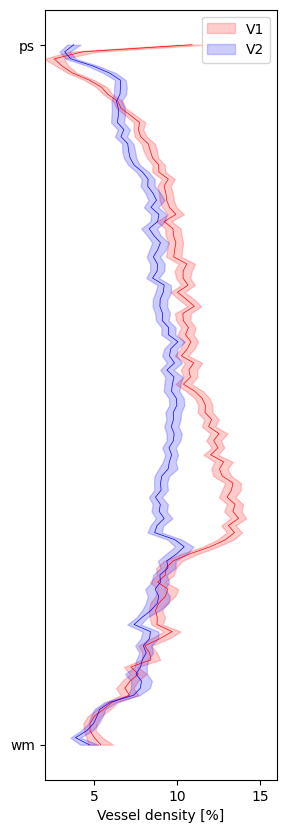

In [127]:
scale_sem = 2
physical_pixel_size_um=(1.03 * 1.03 * 1)

for mode in ['cyto', 'angio']:
    area_dfs = []
    for region in ['v1', 'v2']:
        index_name = region + '_cyto_metric.upsampled'
        manual_layers = ds.get_entry(index_name)['measurements']['manual.layers']
        manual_layer_boundaries_Rdepth = manual_layers['manual_layer_boundary_Rdepths']
        manual_layer_names = manual_layers['manual_layer_names']
        #depth_indicator_Rdepths = manual_layers['depth_indicator_Rdepths']
        #depth_indicator_Pdepths = manual_layers['depth_indicator_Pdepths']
        #peak_df = {'peak': depth_indicator_Rdepths, 
        #           'label': depth_indicator_Pdepths, 
        #           'color': [[0, 0, 0, 1] for i in depth_indicator_Pdepths]}

        if mode == 'angio':
            data_name = region + '_angio_LTtransform'
            angio_density_pp = ds.get_measurements(data_name)['LT.density_pp']
            angio_density_pp = pd.read_csv(angio_density_pp)
            #angio_density_pc = ds.get_measurements(data_name)['LT.density_pc']
            #angio_density_pc = pd.read_csv(angio_density_pc)
            area_dfs.append(angio_density_pp)
            
        if mode == 'cyto':
            data_name = region + '_cyto_cellcenters'
            cyto_density_pp = ds.get_measurements(data_name)['density_pp']
            cyto_density_pp = pd.read_csv(cyto_density_pp)
            #cyto_density_pc = ds.get_measurements(data_name)['density_pc']
            #cyto_density_pc = pd.read_csv(cyto_density_pc)
            area_dfs.append(cyto_density_pp)

    fig = pdm_v.cross_area_plot(area_dfs[0], area_dfs[1], 
                                mode=mode, 
                                area_names=['V1', 'V2'], 
                                scale_sem=2, 
                                #manual_layer_boundaries=manual_layer_boundaries_Rdepth, 
                                #manual_layer_names=manual_layer_names, 
                                physical_pixel_size_um=physical_pixel_size_um, 
                                show_legend=True)
    
    plt.savefig(f'{mode}_cross_area_plot.png')

# Get measurements confined to manual layers

### Cyto

In [133]:
%%time

special = 'density.table'
pre_chunk = (10, 2000, 2000)
# NOTE: StarDist labels can be oddly regular at times
# e.g. with cell-centers being restricted to every 4th slice along the z axis
pre_slice = tuple([slice(None, None, 1),  # TODO revert to 1, 1, 1
                   slice(None, None, 1), 
                   slice(None, None, 1)])

for region in ['v1', 'v2']:
    data_name = region + '_cyto_cellcenters'#'v1_cyto_cellcenters'
    index_name = region + '_cyto_metric.upsampled'
    
    manual_layers = ds.get_entry(index_name)['measurements']['manual.layers']
    manual_layer_boundary_Rdepths = manual_layers['manual_layer_boundary_Rdepths']
    depthbins = manual_layer_boundary_Rdepths[::-1]

    hsv_data = False
    wrap_orientation = False
    mask_name = None
    binary_data = True

    databins = None

    ds.measure_density(data_name, index_name, depthbins, databins=databins, 
                       pre_chunk=pre_chunk, pre_slice=pre_slice, hsv_data=hsv_data, 
                       wrap_orientation=wrap_orientation, mask_name=mask_name, 
                       binary_data=binary_data, special=special)

Found previous file: v1_cyto_cellcenters_density.table.csv
Added measurements: density.table to entry v1_cyto_cellcenters

Found previous file: v1_cyto_cellcenters_density.table_pp.csv and v1_cyto_cellcenters_density.table_pv.csv and v1_cyto_cellcenters_density.table_pc.csv
Added measurements: density.table_pp to entry v1_cyto_cellcenters

Added measurements: density.table_pv to entry v1_cyto_cellcenters

Added measurements: density.table_pc to entry v1_cyto_cellcenters

Found previous file: v2_cyto_cellcenters_density.table.csv
Added measurements: density.table to entry v2_cyto_cellcenters

Found previous file: v2_cyto_cellcenters_density.table_pp.csv and v2_cyto_cellcenters_density.table_pv.csv and v2_cyto_cellcenters_density.table_pc.csv
Added measurements: density.table_pp to entry v2_cyto_cellcenters

Added measurements: density.table_pv to entry v2_cyto_cellcenters

Added measurements: density.table_pc to entry v2_cyto_cellcenters

CPU times: user 20.2 ms, sys: 104 µs, total: 20.

In [1498]:
#! rm v1_cyto_cellcenters_density.table.csv
#! rm v1_cyto_cellcenters_density.table_pp.csv 
#! rm v1_cyto_cellcenters_density.table_pv.csv
#! rm v1_cyto_cellcenters_density.table_pc.csv 

### Angio

In [136]:
%%time

for region in ['v1', 'v2']:
    data_name = region + '_angio_orientation.hsv'
    index_name = region + '_cyto_metric.upsampled'
    mask_name = region + '_angio_LoG.segmentation'

    manual_layers = ds.get_entry(index_name)['measurements']['manual.layers']
    manual_layer_boundary_Rdepths = manual_layers['manual_layer_boundary_Rdepths']
    #manual_layer_names = manual_layers['manual_layer_names']
    #depth_indicator_Rdepths = manual_layers['depth_indicator_Rdepths']
    #depth_indicator_Pdepths = manual_layers['depth_indicator_Pdepths']
    #peak_df = {'peak': depth_indicator_Rdepths, 
    #           'label': depth_indicator_Pdepths, 
    #           'color': [[0, 0, 0, 1] for i in depth_indicator_Pdepths]}
    depthbins = manual_layer_boundary_Rdepths[::-1]
    
    special = 'orientation.density.table'
    pre_chunk = (10, 2000, 2000)
    pre_slice = tuple([slice(None, None, 1),  # TODO revert to 1, 1, 1
                       slice(None, None, 1), 
                       slice(None, None, 1)])
    hsv_data = True
    wrap_orientation = True
    binary_data = False

    delta = 0.0001
    orientation_bins = np.array([0+delta, 20, 70, 90])
    orientation_bins = orientation_bins / 180

    data = ds.measure_density(data_name, index_name, depthbins, databins=orientation_bins, 
                              pre_chunk=pre_chunk, pre_slice=pre_slice, hsv_data=hsv_data, 
                              wrap_orientation=wrap_orientation, mask_name=mask_name, 
                              binary_data=binary_data, special=special)

Found previous file: v1_angio_orientation.hsv_orientation.density.table.csv
Added measurements: orientation.density.table to entry v1_angio_orientation.hsv

Found previous file: v1_angio_orientation.hsv_orientation.density.table_pp.csv and v1_angio_orientation.hsv_orientation.density.table_pv.csv and v1_angio_orientation.hsv_orientation.density.table_pc.csv
Added measurements: orientation.density.table_pp to entry v1_angio_orientation.hsv

Added measurements: orientation.density.table_pv to entry v1_angio_orientation.hsv

Added measurements: orientation.density.table_pc to entry v1_angio_orientation.hsv

Could not find previous file: v2_angio_orientation.hsv_orientation.density.table.csv, computing ...
Assuming hsv data: extracting h (the first dim along the last axis) ...
Wrapping orientation: moving the discontinuity from vertical (0) to horizontal (.5) ...
Data after pre_chunk and/or pre_slice:


dask.array<rechunk-merge, shape=(1000, 2000, 2000), dtype=float64, chunksize=(10, 2000, 2000), chunktype=numpy.MaskedArray>

Index after pre_chunk and/or pre_slice:


dask.array<rechunk-merge, shape=(1000, 2000, 2000), dtype=float32, chunksize=(10, 2000, 2000), chunktype=numpy.ndarray>

Added measurements: orientation.density.table to entry v2_angio_orientation.hsv

Could not find previous file: v2_angio_orientation.hsv_orientation.density.table_pp.csv, computing ...
Added measurements: orientation.density.table_pp to entry v2_angio_orientation.hsv

Added measurements: orientation.density.table_pv to entry v2_angio_orientation.hsv

Added measurements: orientation.density.table_pc to entry v2_angio_orientation.hsv

CPU times: user 14min 11s, sys: 6min 50s, total: 21min 1s
Wall time: 3min 22s


In [135]:
#! rm v1_angio_orientation.hsv_orientation.density.table.csv
#! rm v1_angio_orientation.hsv_orientation.density.table_pp.csv
#! rm v1_angio_orientation.hsv_orientation.density.table_pv.csv
#! rm v1_angio_orientation.hsv_orientation.density.table_pc.csv

### Merge into a table

In [194]:
for region in ['v1']:
    index_name = region + '_cyto_metric.upsampled'
    cyto_name = region + '_cyto_cellcenters'
    angio_name = region + '_angio_orientation.hsv'
    physical_pixel_size_um = (1.03 * 1.03 * 1)
    table = ds.tabulate(index_name, cyto_name, angio_name, physical_pixel_size_um)
table.to_excel('plots/v1.xlsx')
table

,layer,relative depth [%],absolute depth [mm],relative width [%],absolute width [mm],cell density [10³ cells per mm³],cell density sem [10³ cells per mm³],total vessel density [%],radial vessel density [%],tangential vessel density [%]
0,I,7.0,0.11,13.0,0.211,41.6,1.3,6.6,2.2,0.9
1,II,16.0,0.27,6.0,0.102,114.4,2.4,8.7,3.2,1.0
2,III,33.0,0.55,28.0,0.466,106.1,2.3,10.1,2.8,1.7
3,IVa,49.0,0.83,5.0,0.090,81.6,2.2,11.5,2.5,2.5
4,IVb,57.0,0.96,10.0,0.166,64.6,2.2,12.8,3.0,2.5
5,IVc,70.0,1.17,15.0,0.252,76.2,3.2,12.6,2.8,2.6
6,V,80.0,1.35,7.0,0.113,65.3,2.9,10.4,2.0,2.4
7,VIa,86.0,1.45,5.0,0.088,77.2,3.6,10.0,1.8,2.4
8,VIb,95.0,1.59,11.0,0.185,58.0,2.3,8.2,1.1,2.5


In [195]:
for region in ['v2']:
    index_name = region + '_cyto_metric.upsampled'
    cyto_name = region + '_cyto_cellcenters'
    angio_name = region + '_angio_orientation.hsv'
    physical_pixel_size_um = (1.03 * 1.03 * 1)
    table = ds.tabulate(index_name, cyto_name, angio_name, physical_pixel_size_um)
table.to_excel('plots/v2.xlsx')
table

,layer,relative depth [%],absolute depth [mm],relative width [%],absolute width [mm],cell density [10³ cells per mm³],cell density sem [10³ cells per mm³],total vessel density [%],radial vessel density [%],tangential vessel density [%]
0,I,6.0,0.09,12.0,0.174,45.2,2.0,6.4,1.8,1.0
1,II,15.0,0.23,6.0,0.088,95.9,3.3,6.9,2.2,0.9
2,III,38.0,0.57,40.0,0.594,62.3,2.9,8.6,2.3,1.5
3,IV,63.0,0.95,11.0,0.164,73.1,4.7,8.6,1.8,1.9
4,V,75.0,1.12,12.0,0.183,46.3,2.8,8.6,1.5,2.2
5,VIa,85.0,1.28,8.0,0.128,42.5,3.0,7.8,1.3,2.2
6,VIb,94.0,1.42,11.0,0.260,27.2,2.1,6.3,0.7,2.1


# Summary data-flow

In [138]:
# NOTE: This view can be convenient to inspect which entries exist, and where they derive from
# One caveat is that we currently do not keep track of all parent-entries of a derivative (but only one)
ds.show_graph()

graph.html


In [147]:
ds.entries.keys()

dict_keys(['v1_cyto', 'v1_angio', 'v2_cyto', 'v2_angio', 'v1_angio_LoG.segmentation', 'v2_angio_LoG.segmentation', 'v1_angio_TubeMap.segmentation', 'v2_angio_TubeMap.segmentation', 'v1_cyto_reg', 'v2_cyto_reg', 'v1_cyto_StarDist.segmentation', 'v2_cyto_StarDist.segmentation', 'v1_angio_orientation.hsv', 'v2_angio_orientation.hsv', 'v1_cyto_downsampled', 'v1_angio_downsampled', 'v2_cyto_downsampled', 'v2_angio_downsampled', 'v1_cyto_cortex.seg', 'v2_cyto_cortex.seg', 'v1_cyto_rim', 'v1_cyto_metric.equidist.valid', 'v2_cyto_rim', 'v2_cyto_metric.equidist.valid', 'v1_cyto_metric.upsampled', 'v2_cyto_metric.upsampled', 'v1_angio_strided.downsampled', 'v2_angio_strided.downsampled', 'v1_angio_Labkit.segmentation.clean', 'v2_angio_Labkit.segmentation.clean', 'v1_angio_Labkit.segmentation.upsampled', 'v2_angio_Labkit.segmentation.upsampled', 'v1_angio_LoG.segmentation.label', 'v1_angio_TubeMap.segmentation.label', 'v2_angio_LoG.segmentation.label', 'v2_angio_TubeMap.segmentation.label', 'v1_a